In [13]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("jessicali9530/celeba-dataset")
path1=path

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/celeba-dataset


In [ ]:

import os
print(os.listdir(path))


['list_landmarks_align_celeba.csv', 'img_align_celeba', 'list_eval_partition.csv', 'list_attr_celeba.csv', 'list_bbox_celeba.csv']


In [14]:
import tensorflow as tf
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time

from IPython import display
import cv2

In [6]:
path=os.path.join(path, "img_align_celeba", "img_align_celeba")

def load_celeba_data(data_dir, max_images=2000):
        """
        Load and preprocess CelebA dataset

        Args:
            data_dir: Directory containing CelebA images
            max_images: Maximum number of images to load
        """
        print(f"Loading CelebA dataset from {data_dir}...")

        # Get image paths
        image_paths = sorted([
    os.path.join(data_dir, fname) for fname in os.listdir(data_dir) if fname.endswith(".jpg")
])[:max_images]

        print(f"Found {len(image_paths)} images")

        images = []
        for i, path in enumerate(image_paths):
            if i % 200 == 0:
                print(f"Processing image {i}/{len(image_paths)}")

            try:
                # Load and resize image
                img = cv2.imread(path)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, (64,64))

                # Normalize to [-1, 1] for tanh activation
                img = (img.astype(np.float32) - 127.5) / 127.5
                images.append(img)

            except Exception as e:
                print(f"Error processing {path}: {e}")
                continue

        return np.array(images)

x_train=load_celeba_data(path)

BUFFER_SIZE = 60000
BATCH_SIZE = 256

train_dataset = tf.data.Dataset.from_tensor_slices(x_train).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)


Loading CelebA dataset from /kaggle/input/celeba-dataset/img_align_celeba/img_align_celeba...
Found 2000 images
Processing image 0/2000
Processing image 200/2000
Processing image 400/2000
Processing image 600/2000
Processing image 800/2000
Processing image 1000/2000
Processing image 1200/2000
Processing image 1400/2000
Processing image 1600/2000
Processing image 1800/2000


In [7]:
def make_generator_model():
   model = tf.keras.Sequential([
            # Foundation for 4x4 image
            layers.Dense(4 * 4 * 1024, use_bias=False, input_shape=(100,)),
            layers.BatchNormalization(),
            layers.LeakyReLU(),
            layers.Reshape((4, 4, 1024)),

            # Upsample to 8x8
            layers.Conv2DTranspose(512, (5, 5), strides=(2, 2), padding='same', use_bias=False),
            layers.BatchNormalization(),
            layers.LeakyReLU(),

            # Upsample to 16x16
            layers.Conv2DTranspose(256, (5, 5), strides=(2, 2), padding='same', use_bias=False),
            layers.BatchNormalization(),
            layers.LeakyReLU(),

            # Upsample to 32x32
            layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False),
            layers.BatchNormalization(),
            layers.LeakyReLU(),

            # Upsample to 64x64
            layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False),
            layers.BatchNormalization(),
            layers.LeakyReLU(),

            # Final layer - output RGB image
            layers.Conv2DTranspose(3, (5, 5), strides=(1, 1),
                                 padding='same', use_bias=False, activation='tanh')
        ], name='generator')

   return model

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


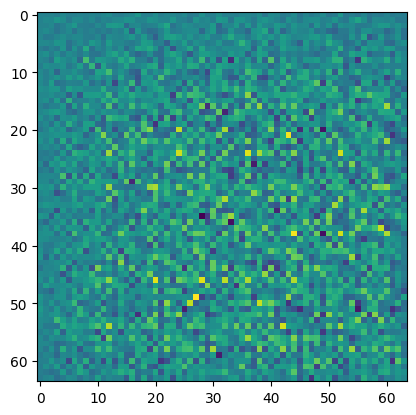

In [8]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0])

In [9]:
def make_discriminator_model():
        """
        Build the discriminator network

        The discriminator classifies images as real or fake.
        Uses convolutional layers with LeakyReLU activation.
        """

        model = tf.keras.Sequential([
            # Input layer
            layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                         input_shape=(64,64,3)),
            layers.LeakyReLU(),
            layers.Dropout(0.3),

            # 32x32 -> 16x16
            layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(),
            layers.Dropout(0.3),

            # 16x16 -> 8x8
            layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(),
            layers.Dropout(0.3),

            # 8x8 -> 4x4
            layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(),
            layers.Dropout(0.3),

            # 4x4 -> 2x2
            layers.Conv2D(1024, (5, 5), strides=(2, 2), padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(),
            layers.Dropout(0.3),

            # Flatten and output
            layers.Flatten(),
            layers.Dense(1, activation='sigmoid')
        ], name='discriminator')

        return model


discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


tf.Tensor([[0.4999892]], shape=(1, 1), dtype=float32)


In [16]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

checkpoint_dir = '/content/checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)


In [17]:
EPOCHS = 100
noise_dim = 100
num_examples_to_generate = 16

gen_losses = []
disc_losses = []

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    return gen_loss, disc_loss

def generate_and_save_images(model, epoch, test_input):
    predictions = model(test_input, training=False)
    predictions = (predictions + 1) / 2.0  # Rescale to [0,1]

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        plt.imshow(predictions[i])
        plt.axis('off')

    plt.savefig(f'/content/checkpoints/image_at_epoch_{epoch:04d}.png')
    plt.show()
    plt.close()




Epoch 1, Gen Loss: 0.8180, Disc Loss: 1.5520


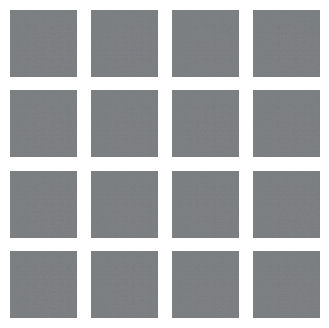

Epoch 2, Gen Loss: 6.0005, Disc Loss: 0.1389


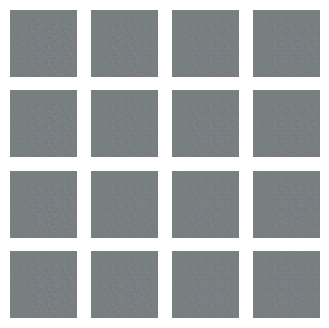

Epoch 3, Gen Loss: 6.0188, Disc Loss: 0.2418


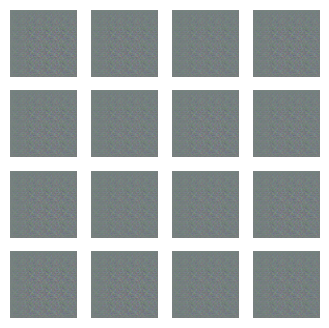

Epoch 4, Gen Loss: 5.7925, Disc Loss: 0.1750


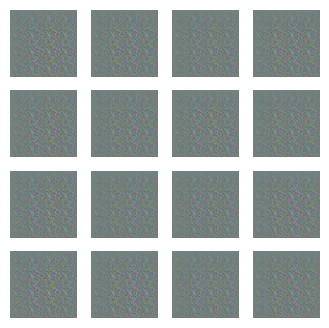

Epoch 5, Gen Loss: 5.5080, Disc Loss: 0.1743


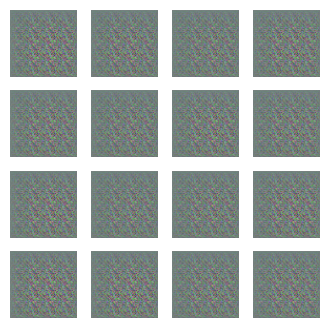

Epoch 6, Gen Loss: 7.3123, Disc Loss: 0.0448


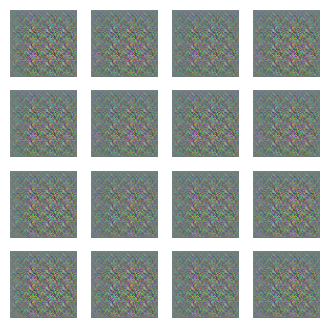

Epoch 7, Gen Loss: 8.9755, Disc Loss: 0.0482


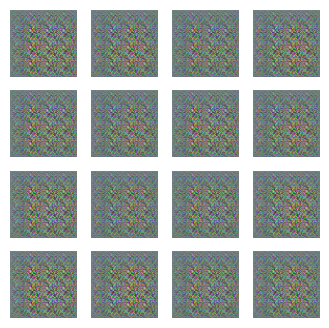

Epoch 8, Gen Loss: 7.9459, Disc Loss: 0.0386


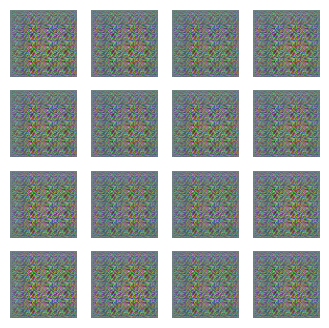

Epoch 9, Gen Loss: 7.9829, Disc Loss: 0.0422


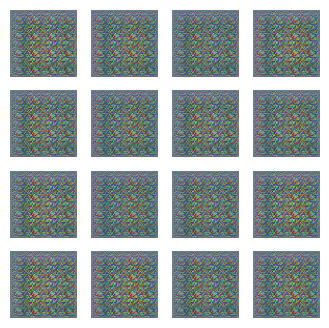

Epoch 10, Gen Loss: 5.9109, Disc Loss: 0.1142


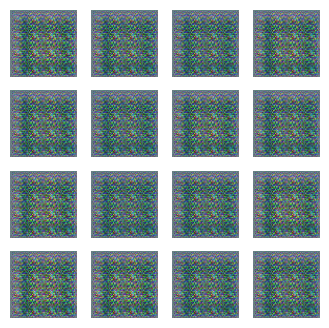

Epoch 11, Gen Loss: 5.5558, Disc Loss: 0.0546


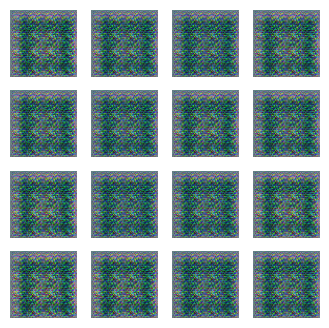

Epoch 12, Gen Loss: 8.2319, Disc Loss: 0.0749


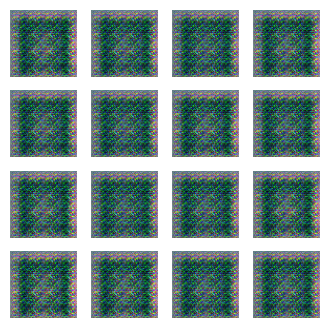

Epoch 13, Gen Loss: 5.7660, Disc Loss: 0.0903


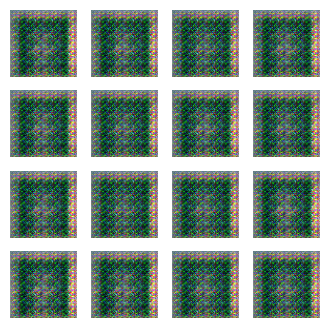

Epoch 14, Gen Loss: 8.0308, Disc Loss: 0.1446


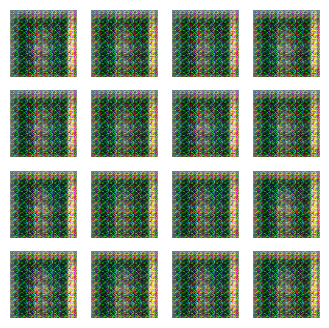

Epoch 15, Gen Loss: 6.2591, Disc Loss: 0.0509


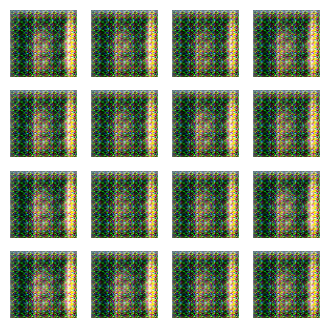

Epoch 16, Gen Loss: 6.8135, Disc Loss: 0.0326


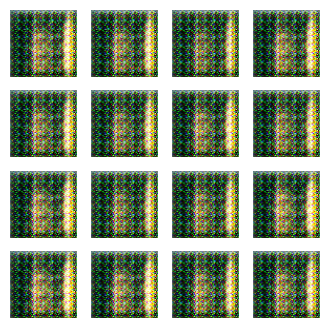

Epoch 17, Gen Loss: 8.3863, Disc Loss: 0.0328


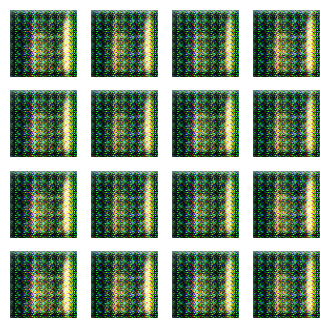

Epoch 18, Gen Loss: 7.7860, Disc Loss: 0.0471


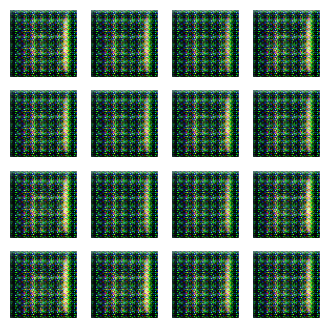

Epoch 19, Gen Loss: 5.2816, Disc Loss: 0.0454


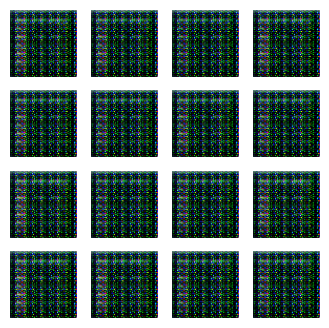

Epoch 20, Gen Loss: 7.3286, Disc Loss: 0.0862


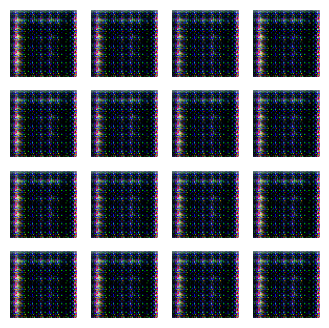

Epoch 21, Gen Loss: 6.9083, Disc Loss: 0.2816


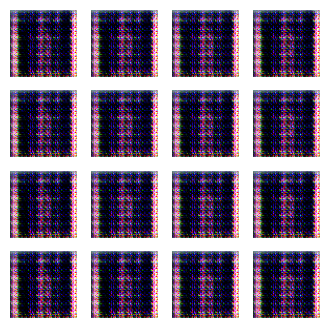

Epoch 22, Gen Loss: 9.4733, Disc Loss: 0.2324


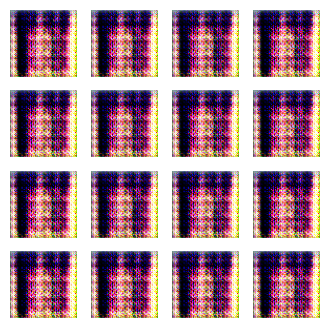

Epoch 23, Gen Loss: 11.2452, Disc Loss: 0.0109


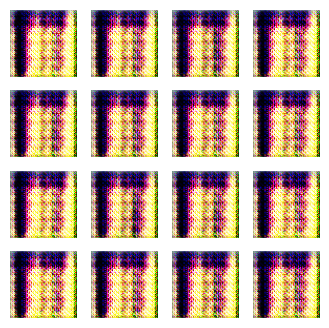

Epoch 24, Gen Loss: 3.9800, Disc Loss: 0.1652


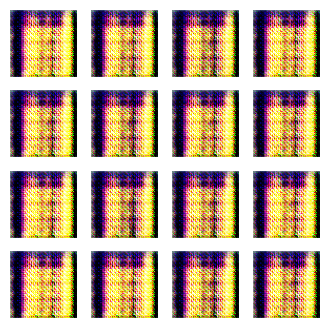

Epoch 25, Gen Loss: 9.9937, Disc Loss: 0.0406


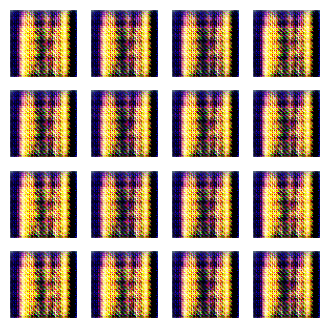

Epoch 26, Gen Loss: 6.5642, Disc Loss: 0.0619


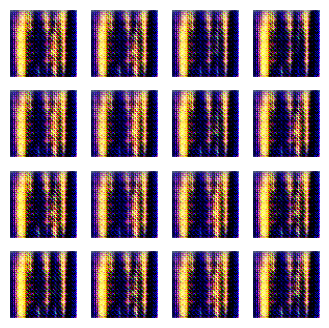

Epoch 27, Gen Loss: 6.0187, Disc Loss: 0.1485


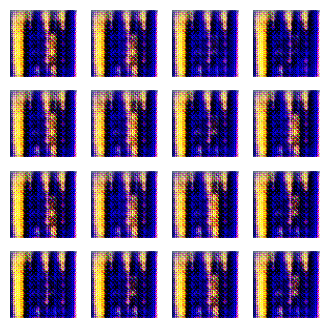

Epoch 28, Gen Loss: 16.8006, Disc Loss: 0.1262


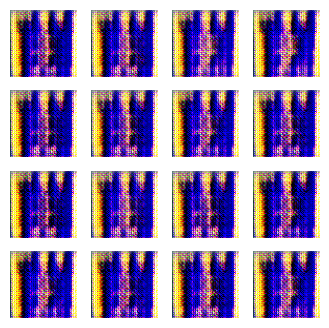

Epoch 29, Gen Loss: 12.4254, Disc Loss: 0.0106


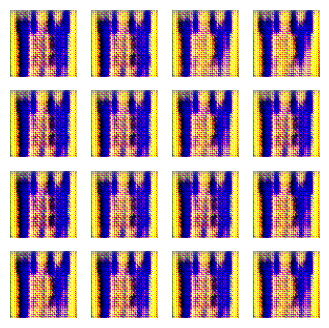

Epoch 30, Gen Loss: 8.4496, Disc Loss: 0.0132


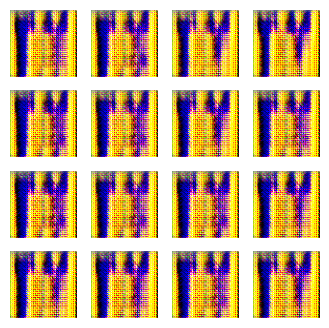

Epoch 31, Gen Loss: 8.1027, Disc Loss: 0.0102


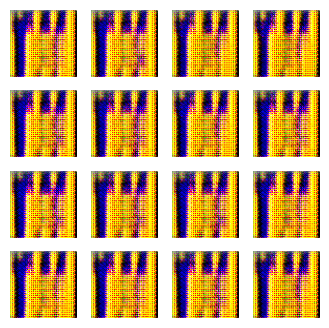

Epoch 32, Gen Loss: 8.5532, Disc Loss: 0.0626


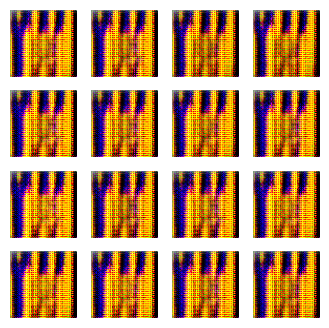

Epoch 33, Gen Loss: 9.0547, Disc Loss: 0.0187


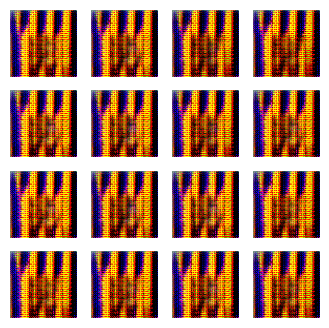

Epoch 34, Gen Loss: 8.9609, Disc Loss: 0.0331


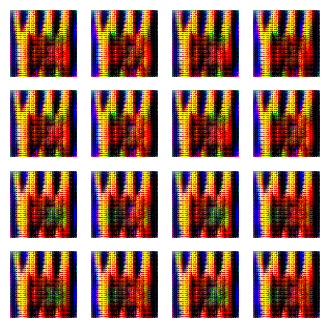

Epoch 35, Gen Loss: 7.4736, Disc Loss: 0.0057


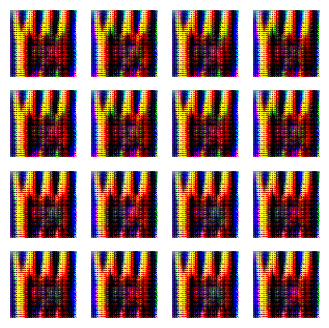

Epoch 36, Gen Loss: 6.2018, Disc Loss: 0.0260


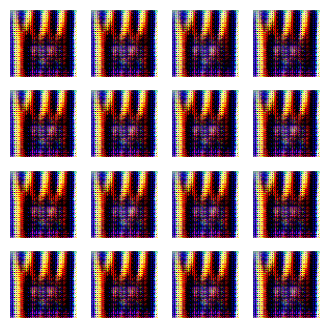

Epoch 37, Gen Loss: 5.7260, Disc Loss: 0.0239


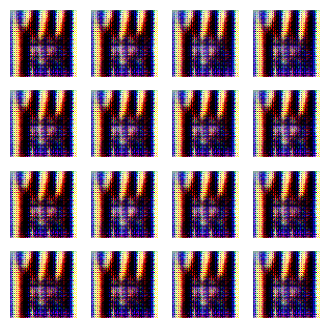

Epoch 38, Gen Loss: 7.8882, Disc Loss: 0.0200


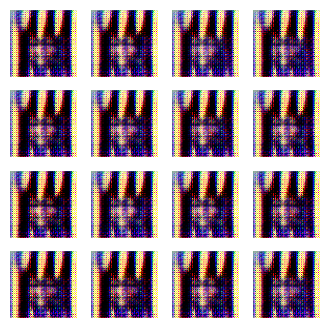

Epoch 39, Gen Loss: 6.4579, Disc Loss: 0.0268


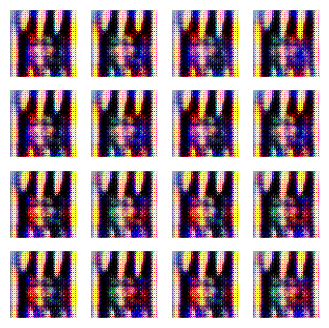

Epoch 40, Gen Loss: 6.1068, Disc Loss: 0.0289


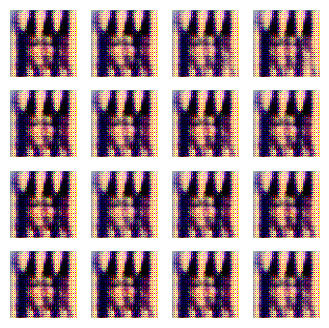

Epoch 41, Gen Loss: 6.9600, Disc Loss: 0.0102


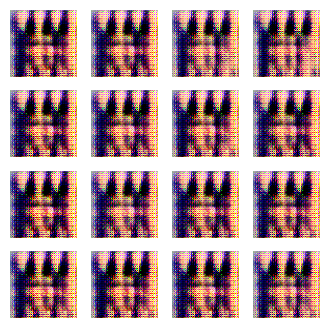

Epoch 42, Gen Loss: 8.0357, Disc Loss: 0.0267


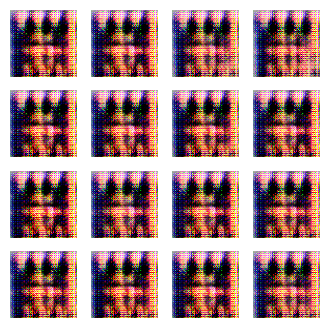

Epoch 43, Gen Loss: 5.8065, Disc Loss: 0.0299


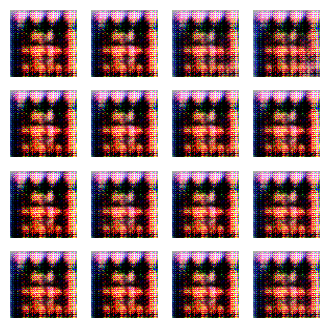

Epoch 44, Gen Loss: 6.7297, Disc Loss: 0.0216


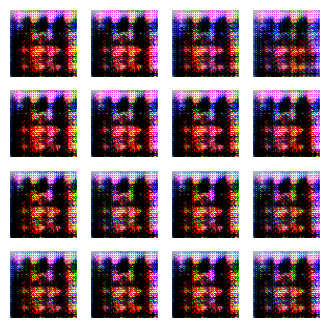

Epoch 45, Gen Loss: 6.3649, Disc Loss: 0.0373


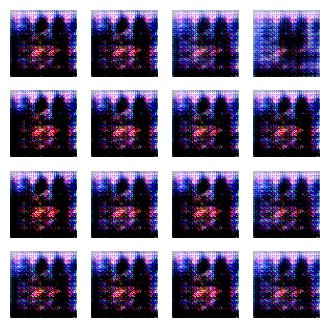

Epoch 46, Gen Loss: 5.0277, Disc Loss: 0.0335


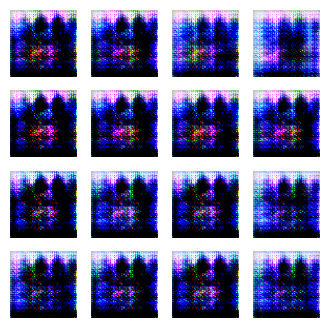

Epoch 47, Gen Loss: 7.5409, Disc Loss: 0.0149


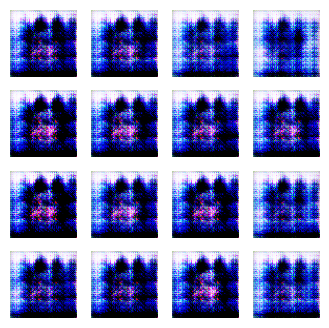

Epoch 48, Gen Loss: 6.6561, Disc Loss: 0.2029


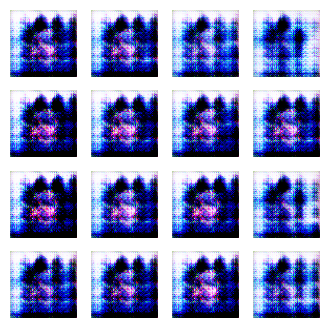

Epoch 49, Gen Loss: 6.8848, Disc Loss: 0.0441


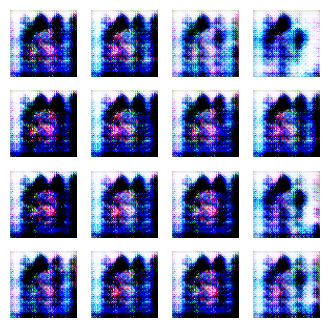

Epoch 50, Gen Loss: 5.0471, Disc Loss: 0.0779


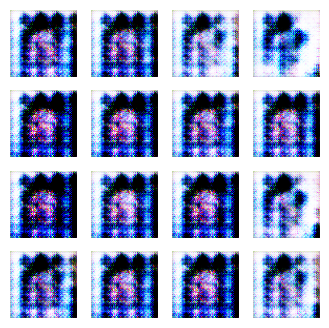

Epoch 51, Gen Loss: 8.9673, Disc Loss: 0.0151


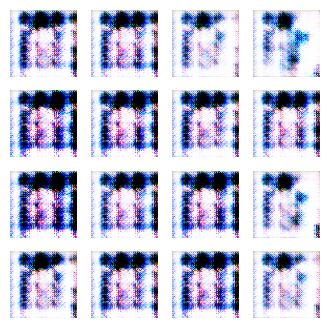

Epoch 52, Gen Loss: 3.6531, Disc Loss: 0.4176


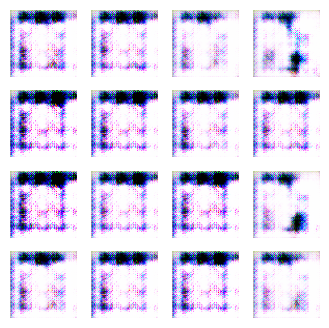

Epoch 53, Gen Loss: 3.7667, Disc Loss: 0.0863


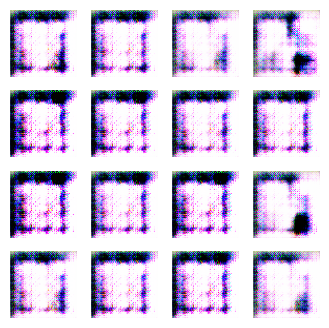

Epoch 54, Gen Loss: 6.1741, Disc Loss: 0.0327


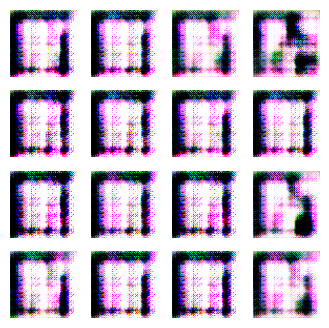

Epoch 55, Gen Loss: 6.4962, Disc Loss: 0.1263


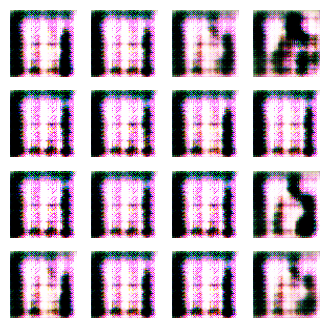

Epoch 56, Gen Loss: 3.0168, Disc Loss: 0.2215


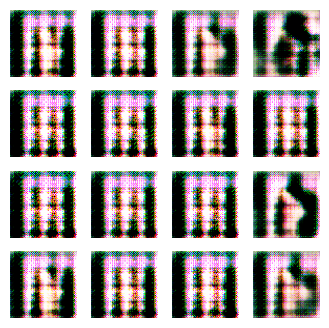

Epoch 57, Gen Loss: 5.8234, Disc Loss: 0.2293


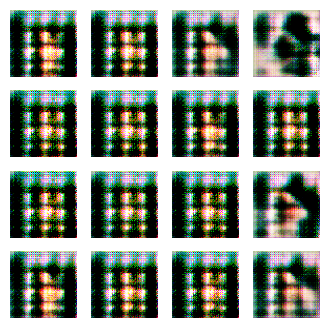

Epoch 58, Gen Loss: 5.3914, Disc Loss: 0.0376


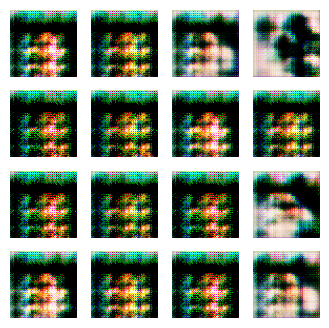

Epoch 59, Gen Loss: 6.9100, Disc Loss: 0.1075


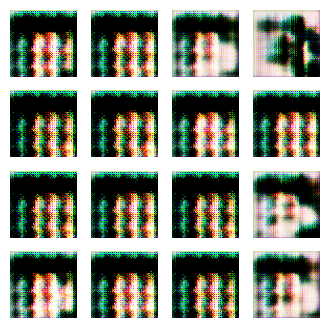

Epoch 60, Gen Loss: 8.8159, Disc Loss: 0.0105


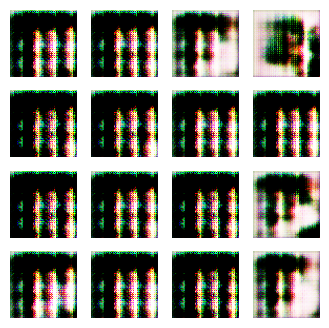

Epoch 61, Gen Loss: 8.5422, Disc Loss: 0.0068


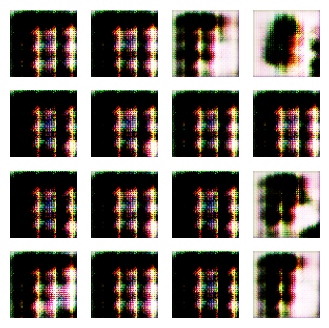

Epoch 62, Gen Loss: 6.8669, Disc Loss: 0.0220


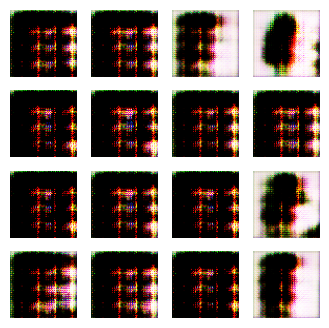

Epoch 63, Gen Loss: 7.2996, Disc Loss: 0.0074


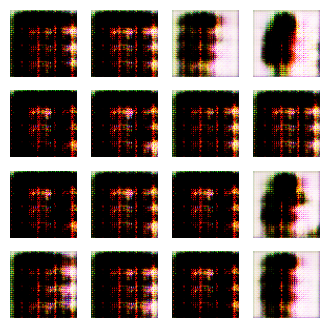

Epoch 64, Gen Loss: 6.9391, Disc Loss: 0.0127


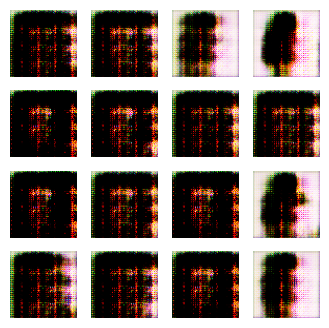

Epoch 65, Gen Loss: 5.5490, Disc Loss: 0.0228


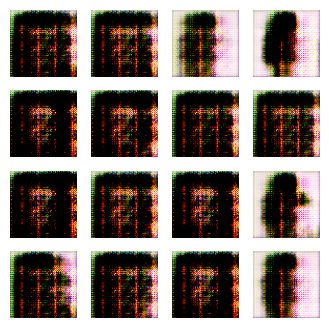

Epoch 66, Gen Loss: 6.5111, Disc Loss: 0.0176


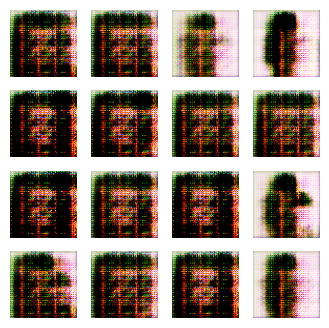

Epoch 67, Gen Loss: 6.7074, Disc Loss: 0.0296


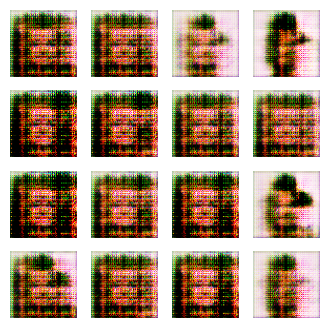

Epoch 68, Gen Loss: 4.8269, Disc Loss: 0.0717


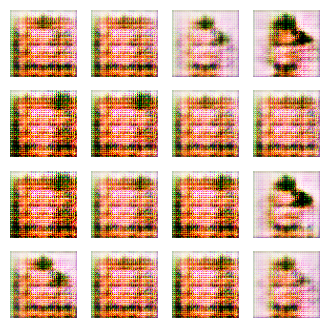

Epoch 69, Gen Loss: 4.7347, Disc Loss: 0.0394


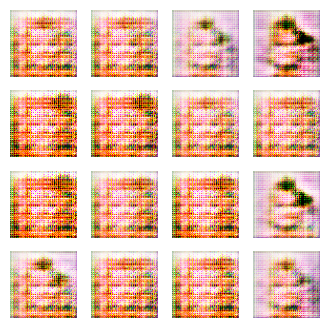

Epoch 70, Gen Loss: 4.9373, Disc Loss: 0.1714


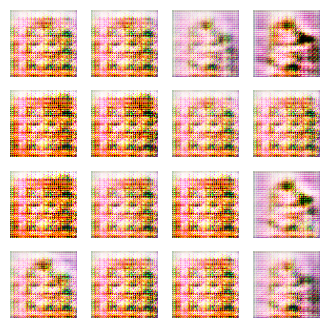

Epoch 71, Gen Loss: 6.0315, Disc Loss: 0.0602


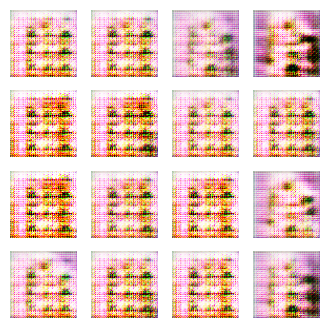

Epoch 72, Gen Loss: 5.8511, Disc Loss: 0.0528


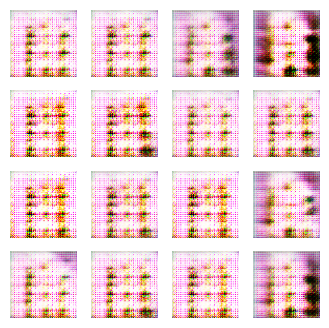

Epoch 73, Gen Loss: 6.9102, Disc Loss: 0.0336


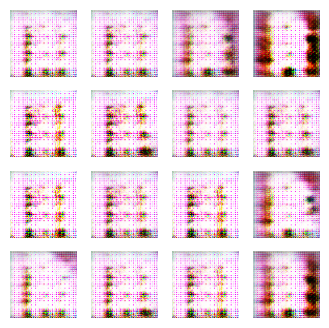

Epoch 74, Gen Loss: 6.4266, Disc Loss: 0.0664


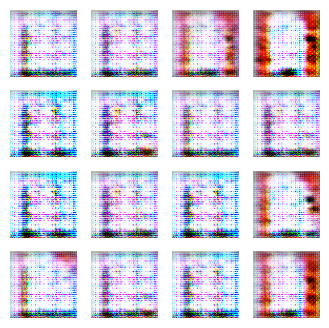

Epoch 75, Gen Loss: 10.8354, Disc Loss: 0.0422


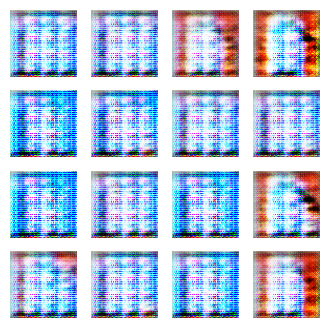

Epoch 76, Gen Loss: 10.4365, Disc Loss: 0.0552


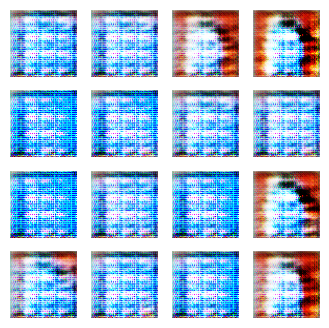

Epoch 77, Gen Loss: 6.5403, Disc Loss: 0.0303


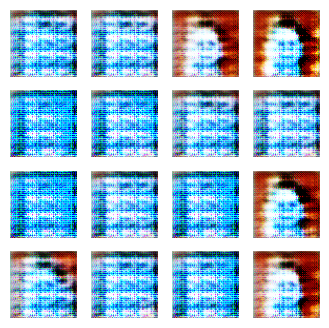

Epoch 78, Gen Loss: 5.5610, Disc Loss: 0.0243


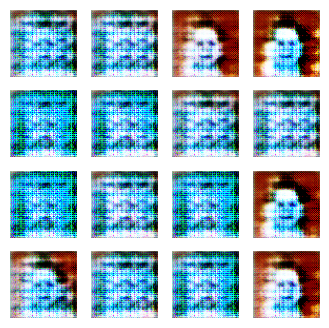

Epoch 79, Gen Loss: 5.9173, Disc Loss: 0.1068


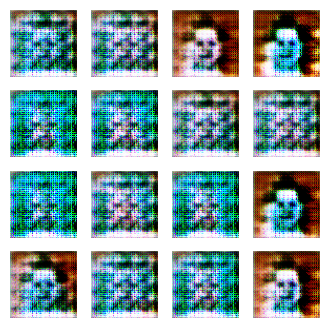

Epoch 80, Gen Loss: 3.7849, Disc Loss: 0.0795


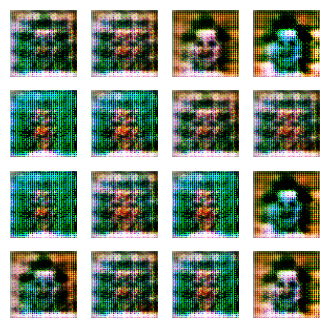

Epoch 81, Gen Loss: 4.7069, Disc Loss: 0.0387


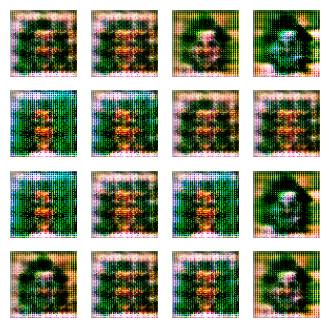

Epoch 82, Gen Loss: 4.6671, Disc Loss: 0.0761


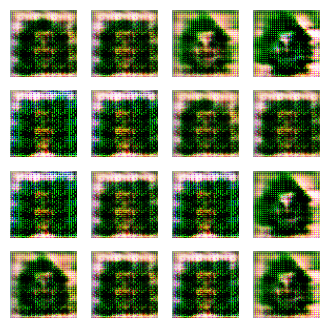

Epoch 83, Gen Loss: 3.8235, Disc Loss: 0.1128


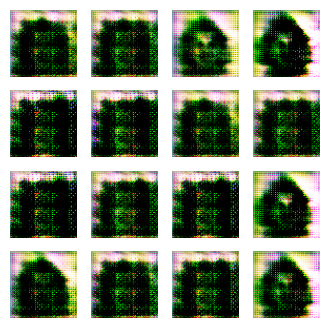

Epoch 84, Gen Loss: 9.4697, Disc Loss: 0.0006


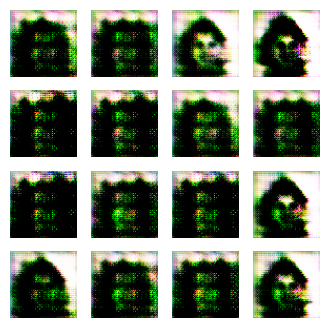

Epoch 85, Gen Loss: 13.8538, Disc Loss: 0.0001


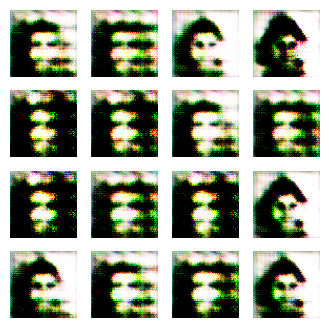

Epoch 86, Gen Loss: 29.0091, Disc Loss: 0.1603


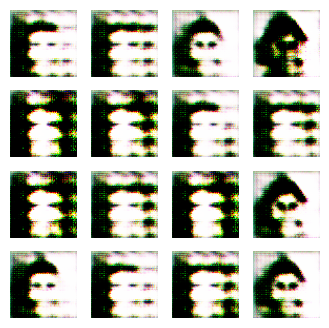

Epoch 87, Gen Loss: 19.7017, Disc Loss: 0.0004


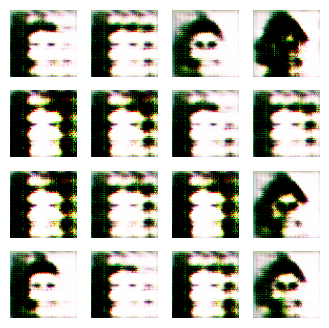

Epoch 88, Gen Loss: 10.5419, Disc Loss: 0.0025


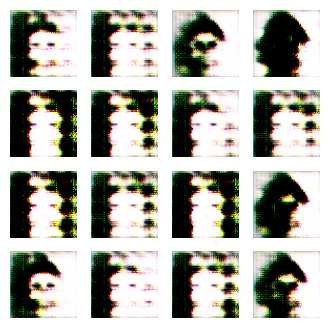

Epoch 89, Gen Loss: 8.2184, Disc Loss: 0.0021


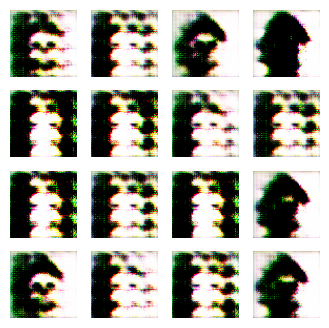

Epoch 90, Gen Loss: 5.1269, Disc Loss: 0.0489


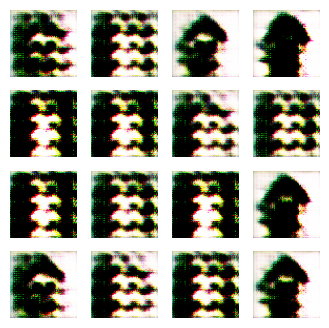

Epoch 91, Gen Loss: 5.7162, Disc Loss: 0.1841


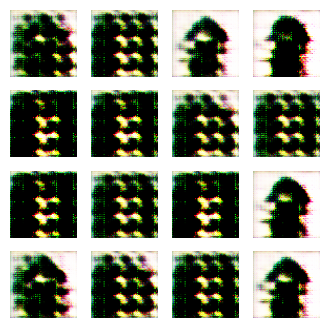

Epoch 92, Gen Loss: 5.6897, Disc Loss: 0.1553


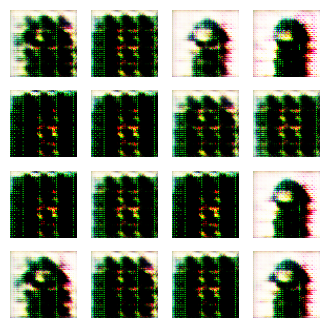

Epoch 93, Gen Loss: 5.8423, Disc Loss: 0.0269


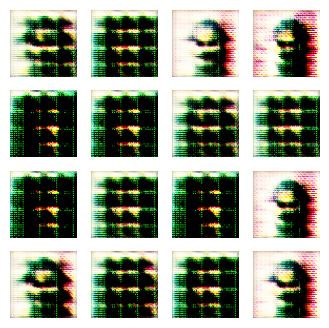

Epoch 94, Gen Loss: 4.4221, Disc Loss: 0.0723


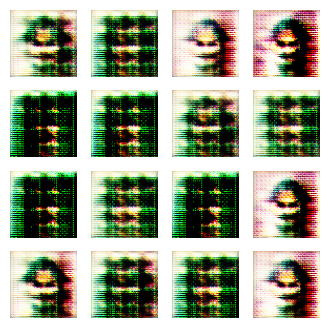

Epoch 95, Gen Loss: 7.4746, Disc Loss: 0.0604


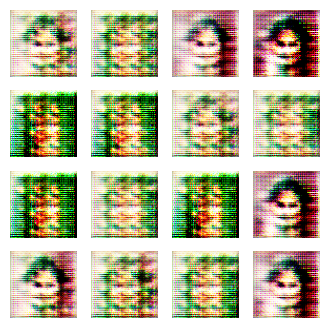

Epoch 96, Gen Loss: 6.4109, Disc Loss: 0.0640


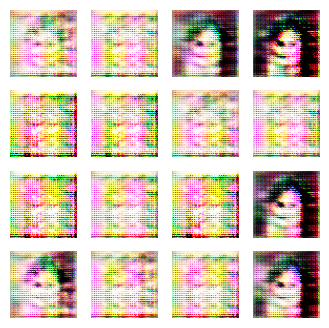

Epoch 97, Gen Loss: 5.7380, Disc Loss: 0.0358


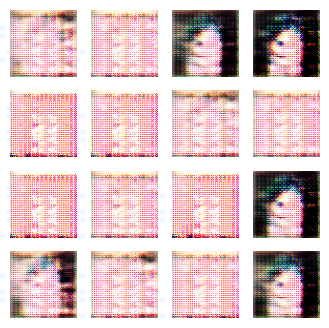

Epoch 98, Gen Loss: 7.6702, Disc Loss: 0.0103


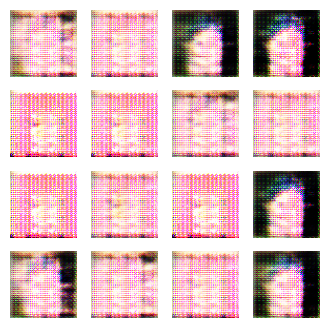

Epoch 99, Gen Loss: 7.8166, Disc Loss: 0.1667


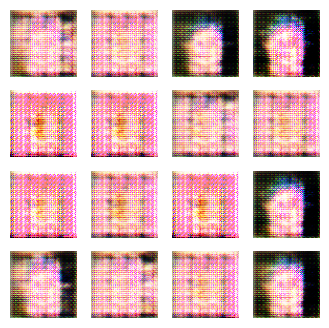

Epoch 100, Gen Loss: 5.7635, Disc Loss: 0.0401


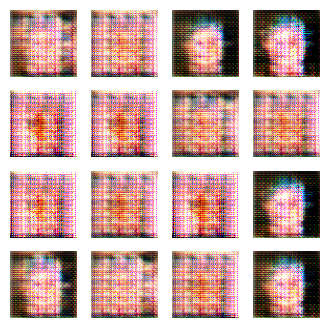

In [18]:
seed = tf.random.normal([16, 100])

for epoch in range(1, EPOCHS + 1):
    for image_batch in train_dataset:
        g_loss, d_loss = train_step(image_batch)
        gen_losses.append(g_loss.numpy())
        disc_losses.append(d_loss.numpy())
    print(f"Epoch {epoch}, Gen Loss: {g_loss.numpy():.4f}, Disc Loss: {d_loss.numpy():.4f}")
    generate_and_save_images(generator, epoch, seed)

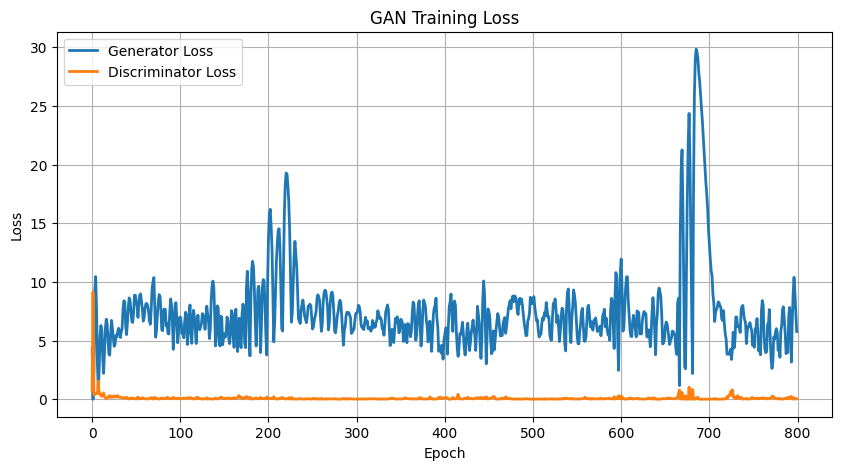

In [21]:
# Loss curve plotting
def plot_loss_curve():
    plt.figure(figsize=(10, 5))
    plt.plot(gen_losses, label="Generator Loss", linewidth=2)
    plt.plot(disc_losses, label="Discriminator Loss", linewidth=2)
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("GAN Training Loss")
    plt.legend()
    plt.grid(True)
    plt.savefig("checkpoints/loss_curve.png", dpi=300)
    plt.show()

plot_loss_curve()

#Conditional GAN

TensorFlow version: 2.18.0
GPU Available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Loading CelebA dataset...
Loading CelebA attributes...
Loaded attributes for 202599 images
Available attributes: ['image_id', '5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive', 'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose', 'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows', 'Chubby', 'Double_Chin', 'Eyeglasses', 'Goatee', 'Gray_Hair', 'Heavy_Makeup', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open', 'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin', 'Pointy_Nose', 'Receding_Hairline', 'Rosy_Cheeks', 'Sideburns', 'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings', 'Wearing_Hat', 'Wearing_Lipstick', 'Wearing_Necklace', 'Wearing_Necktie', 'Young']
Looking for images in: /kaggle/input/celeba-dataset/img_align_celeba/img_align_celeba/
Found 202599 total images
Limited to 1500 samples for training
Loading and processing images..

/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "celeba_generator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ label_input         │ (None, 1)         │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_21        │ (None, 1, 64)     │        128 │ label_input[0][0] │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ noise_input         │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_30          │ (None, 64)        │          0 │ embedding_21[0][… │
│ (Flatten)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_12      │ (None, 192)       │          0 │ noise_input[0][0… │
│ (Concatenate)       │                   │            │ flatten_30[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_25 (Dense)    │ (None, 16384)     │  3,145,728 │ concatenate_12[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16384)     │     65,536 │ dense_25[0][0]    │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_8 (ReLU)      │ (None, 16384)     │          0 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_22          │ (None, 4, 4,      │          0 │ re_lu_8[0][0]     │
│ (Reshape)           │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_39 │ (None, 8, 8, 512) │  8,388,608 │ reshape_22[0][0]  │
│ (Conv2DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 8, 8, 512) │      2,048 │ conv2d_transpose… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_9 (ReLU)      │ (None, 8, 8, 512) │          0 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_40 │ (None, 16, 16,    │  2,097,152 │ re_lu_9[0][0]     │
│ (Conv2DTranspose)   │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │      1,024 │ conv2d_transpose… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_10 (ReLU)     │ (None, 16, 16,    │          0 │ batch_normalizat… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_41 │ (None, 32, 32,    │    524,288 │ re_lu_10[0][0]    │
│ (Conv2DTranspose)   │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        512 │ conv2d_transpose… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_11 (ReLU)     │ (None, 32, 32,    │          0 │ batch_normalizat

 Total params: 14,358,083 (54.77 MB)

 Trainable params: 14,323,395 (54.64 MB)

 Non-trainable params: 34,688 (135.50 KB)


CelebA Discriminator summary:


Model: "celeba_discriminator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ label_input         │ (None, 1)         │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_22        │ (None, 1, 64)     │        128 │ label_input[0][0] │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_26 (Dense)    │ (None, 1, 12288)  │    798,720 │ embedding_22[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ image_input         │ (None, 64, 64, 3) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_23          │ (None, 64, 64, 3) │          0 │ dense_26[0][0]    │
│ (Reshape)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_13      │ (None, 64, 64, 6) │          0 │ image_input[0][0… │
│ (Concatenate)       │                   │            │ reshape_23[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_35 (Conv2D)  │ (None, 32, 32,    │      6,208 │ concatenate_13[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_65      │ (None, 32, 32,    │          0 │ conv2d_35[0][0]   │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_22          │ (None, 32, 32,    │          0 │ leaky_re_lu_65[0… │
│ (Dropout)           │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_36 (Conv2D)  │ (None, 16, 16,    │    131,200 │ dropout_22[0][0]  │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │        512 │ conv2d_36[0][0]   │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_66      │ (None, 16, 16,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_23          │ (None, 16, 16,    │          0 │ leaky_re_lu_66[0… │
│ (Dropout)           │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_37 (Conv2D)  │ (None, 8, 8, 256) │    524,544 │ dropout_23[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 8, 8, 256) │      1,024 │ conv2d_37[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_67      │ (None, 8, 8, 256) │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_24          │ (None, 8, 8, 256) │          0 │ leaky_re_lu_67[0… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 3,570,241 (13.62 MB)

 Trainable params: 3,568,449 (13.61 MB)

 Non-trainable params: 1,792 (7.00 KB)

Sample of loaded CelebA data:


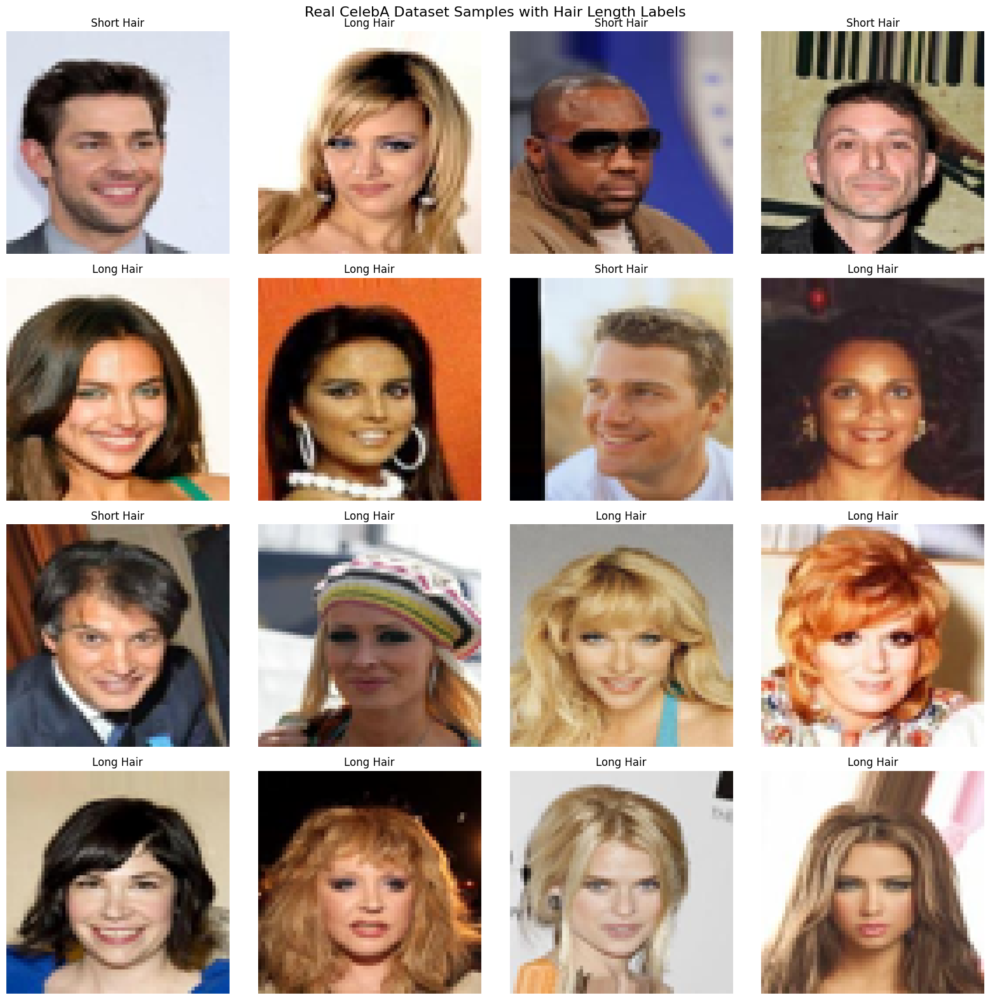

Training CelebA CGAN...
Starting CelebA CGAN training...
Epoch 0: Gen Loss: 5.0931, Disc Loss: 1.0216


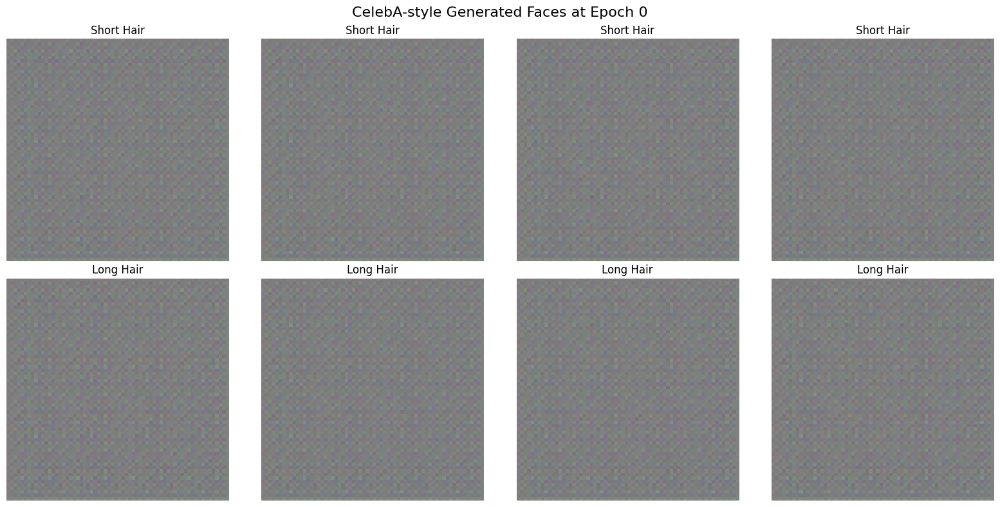

Epoch 20: Gen Loss: 3.0881, Disc Loss: 1.3146


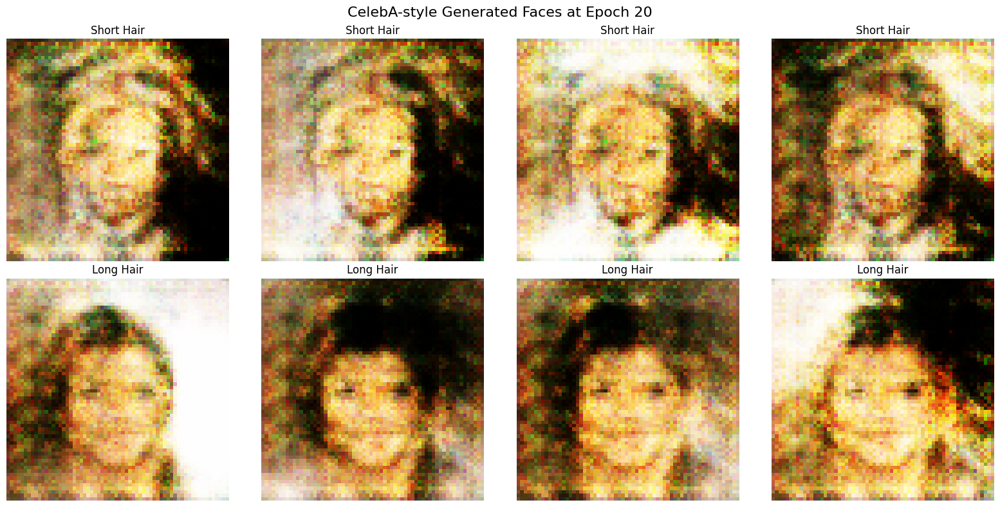

Epoch 40: Gen Loss: 1.8560, Disc Loss: 1.1634


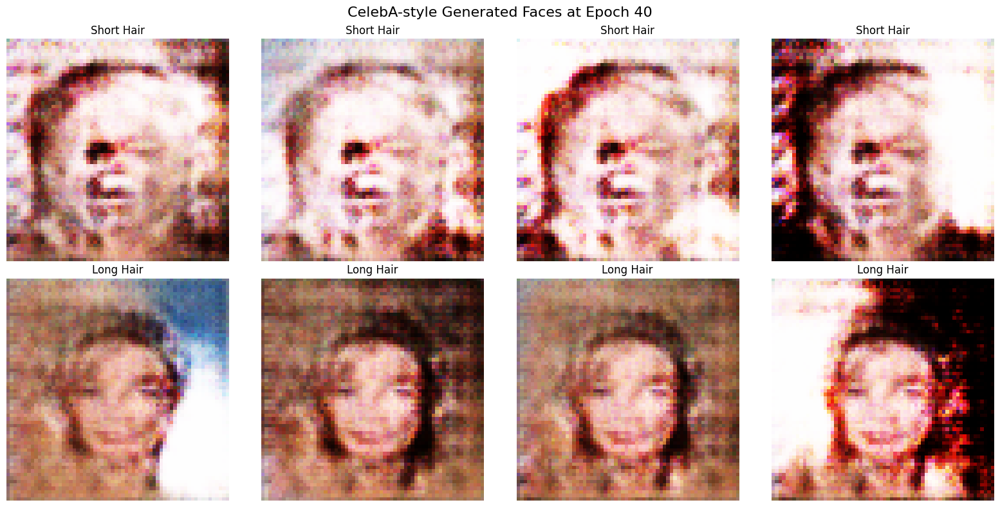

Epoch 60: Gen Loss: 2.5552, Disc Loss: 1.0823


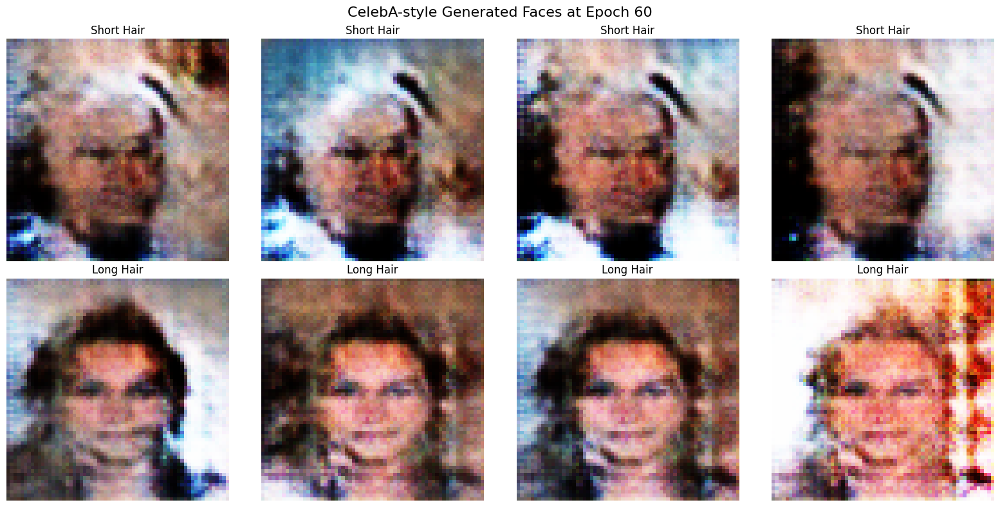

Epoch 80: Gen Loss: 2.4488, Disc Loss: 1.1036


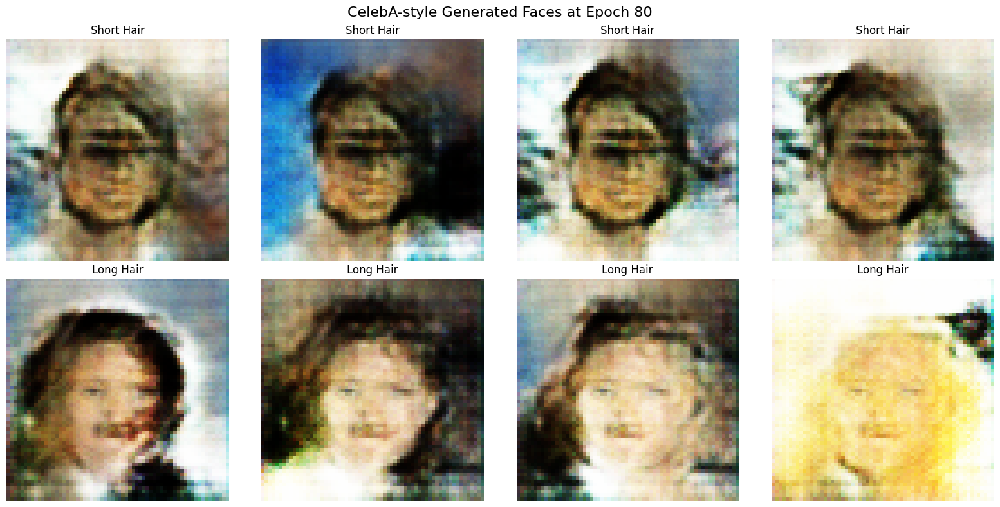

Epoch 100: Gen Loss: 2.5408, Disc Loss: 0.9555


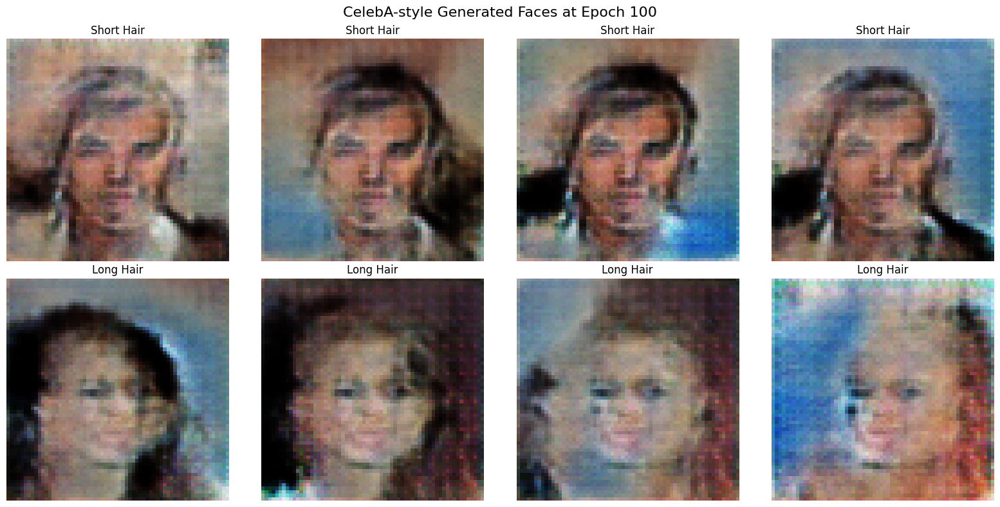

Epoch 120: Gen Loss: 2.4759, Disc Loss: 0.9072


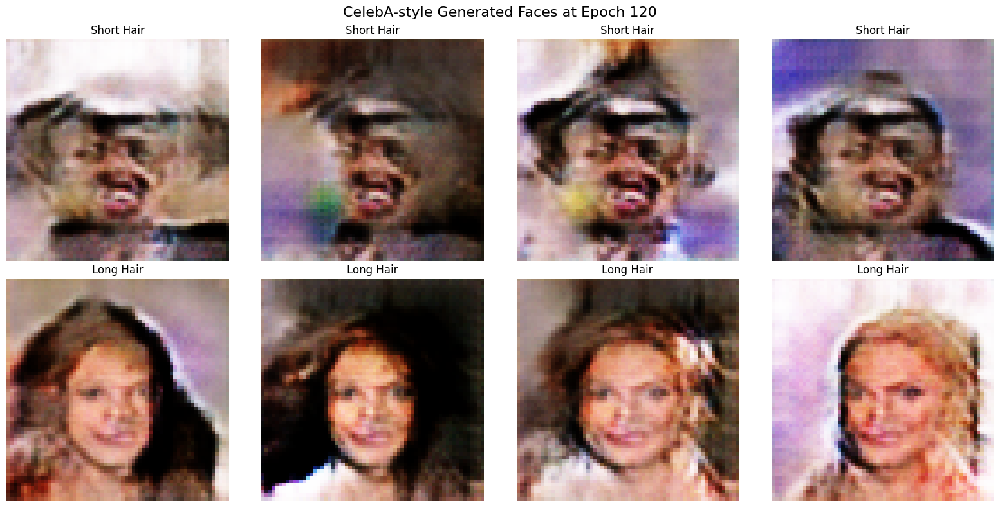

Epoch 140: Gen Loss: 2.8799, Disc Loss: 0.8049


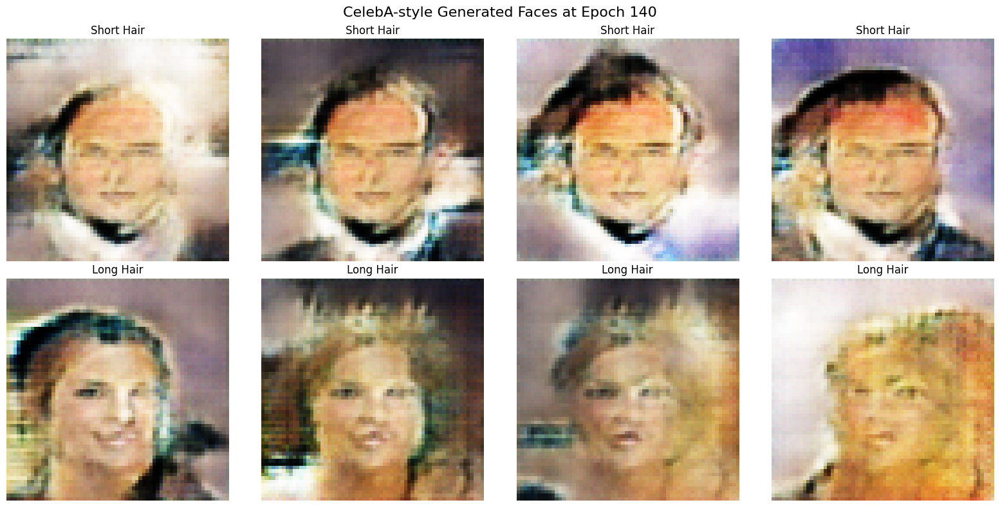

Epoch 160: Gen Loss: 2.5681, Disc Loss: 0.8916


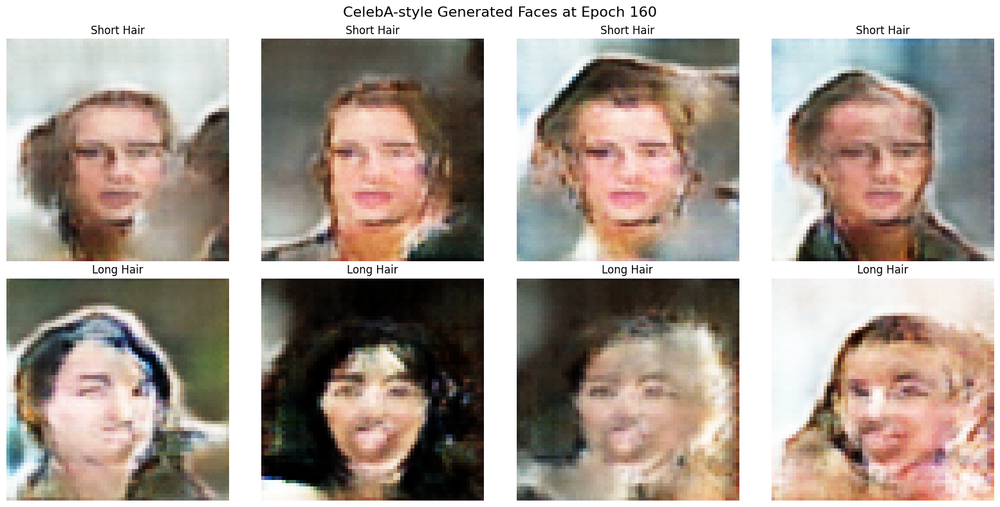

Epoch 180: Gen Loss: 2.2950, Disc Loss: 0.8679


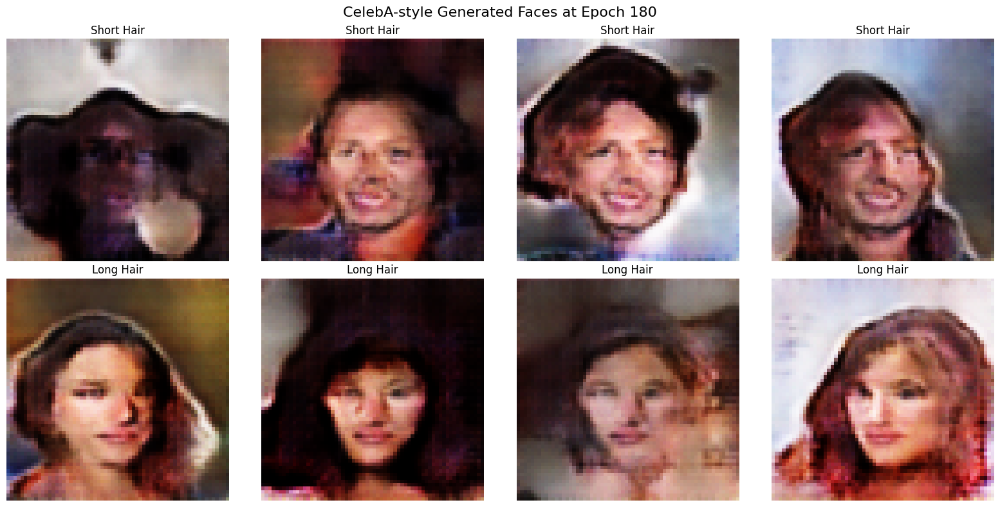

Epoch 200: Gen Loss: 2.2982, Disc Loss: 0.8468


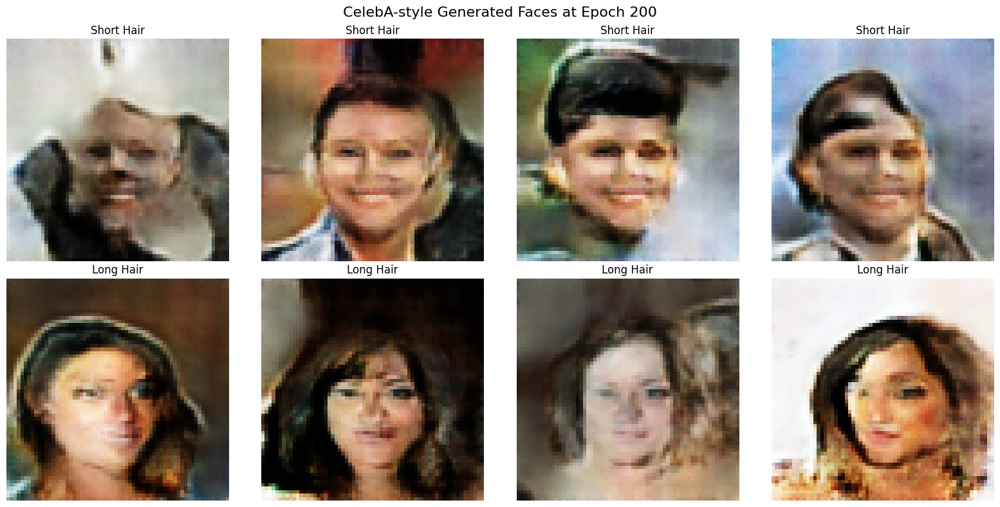

Epoch 220: Gen Loss: 2.4880, Disc Loss: 0.7987


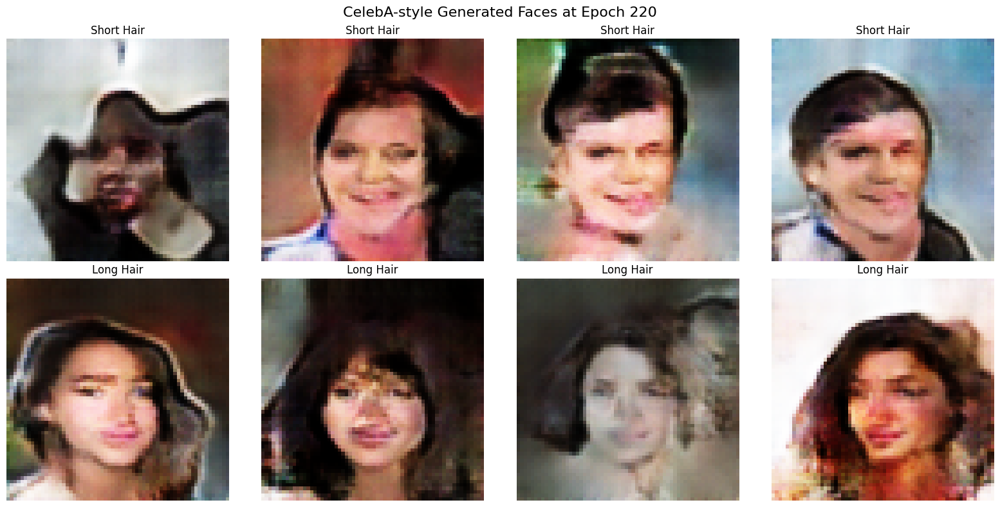

Epoch 240: Gen Loss: 2.5241, Disc Loss: 0.7614


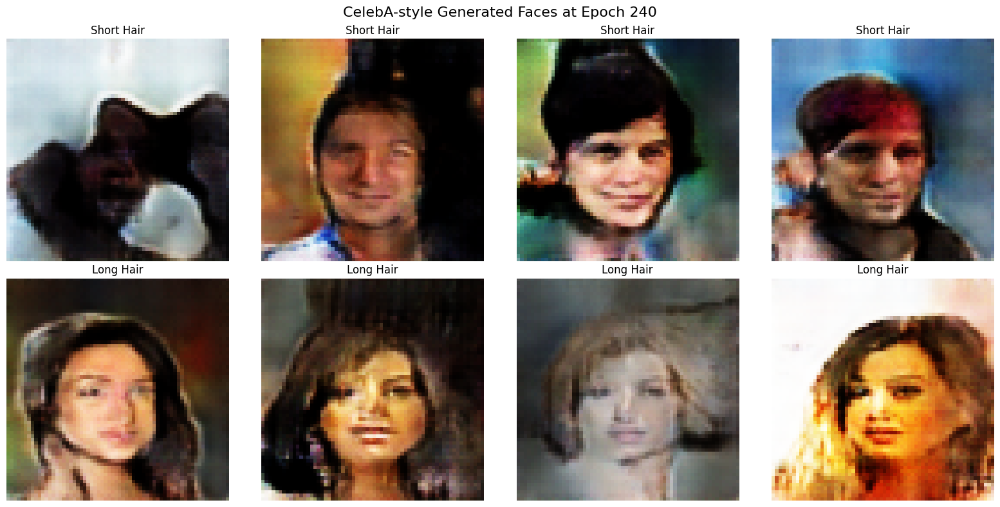

Epoch 260: Gen Loss: 2.7795, Disc Loss: 0.7547


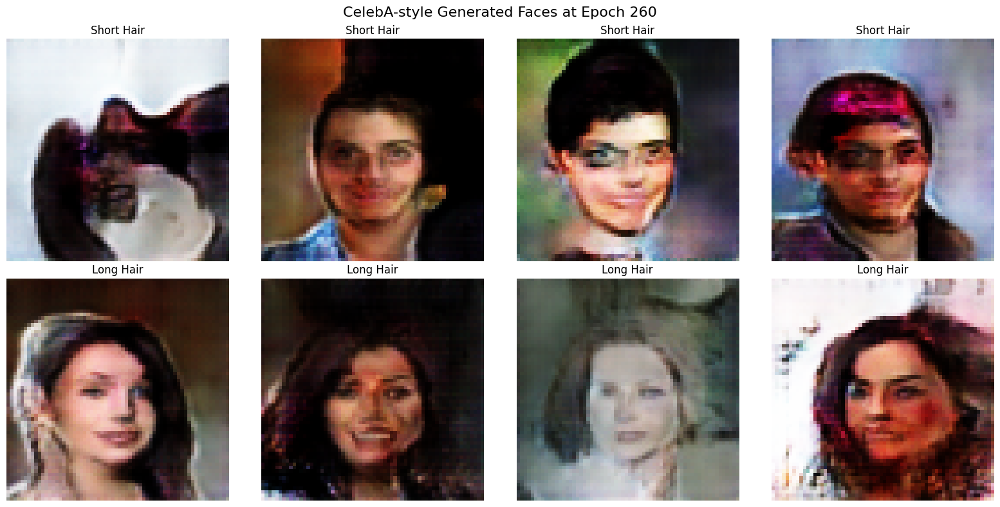

Epoch 280: Gen Loss: 2.7431, Disc Loss: 0.7055


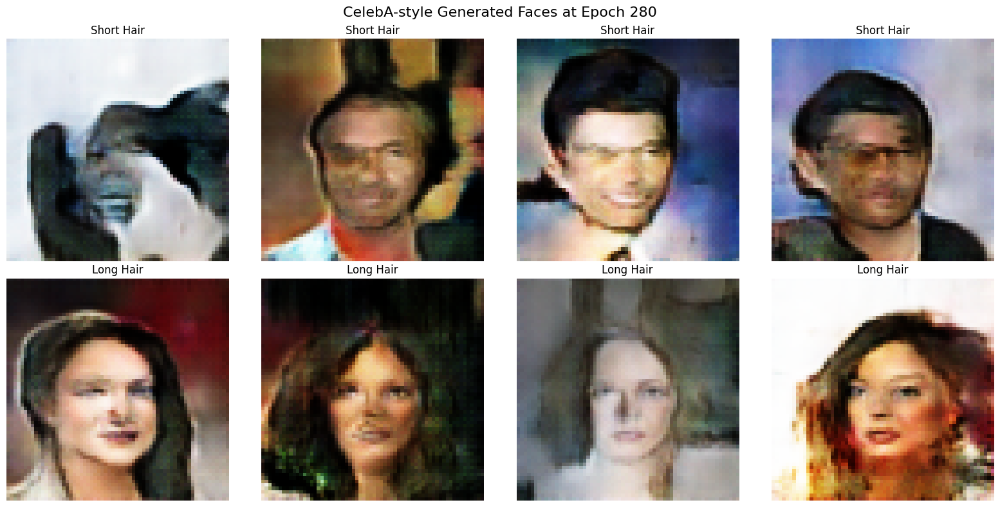

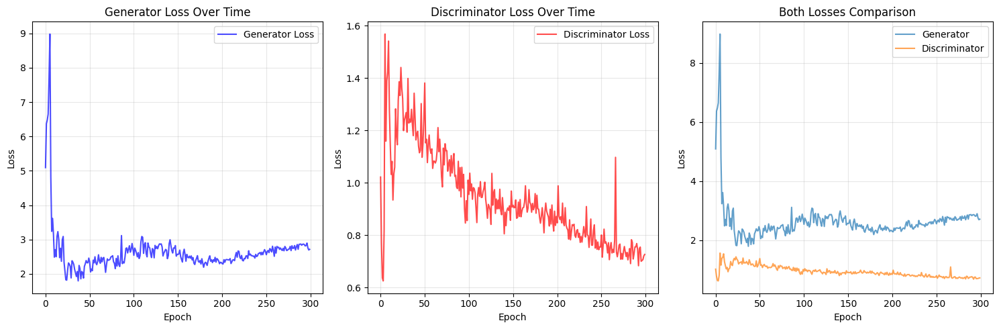

Generating final CelebA-style results...


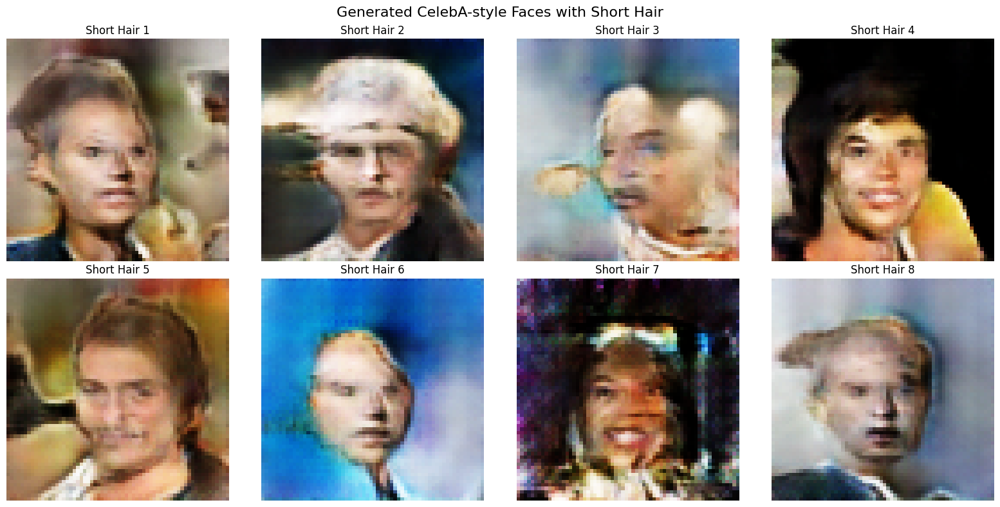

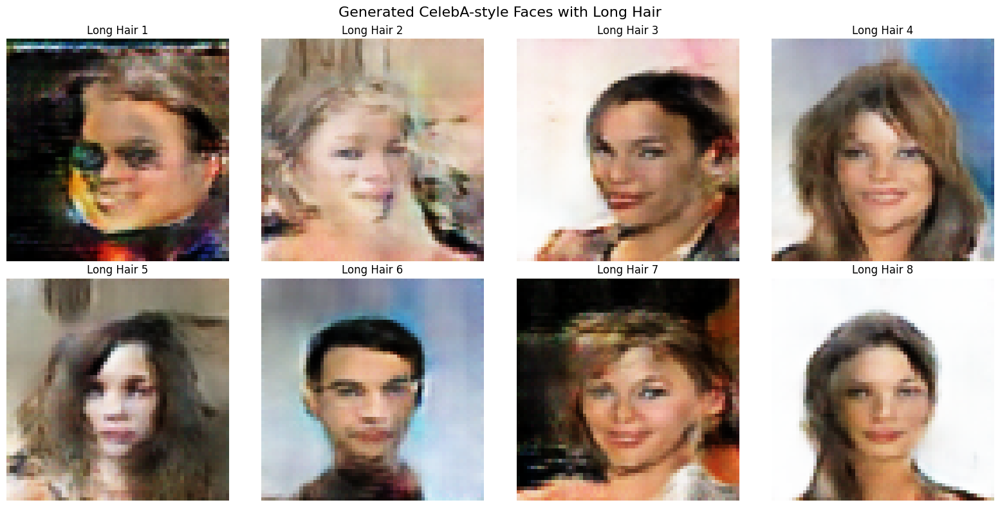

CelebA CGAN training completed!
Results saved in: output/
Setup complete! Update the CELEBA_PATH in the config and run the cells to train on your CelebA dataset.


In [ ]:
# Conditional GAN for CelebA Face Generation with Hair Length Conditioning
# Author: AI Assistant
# Description: CGAN implementation for CelebA dataset with hair length detection

# Cell 1: Import Libraries and Setup
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import os
from PIL import Image
import cv2
import pandas as pd
from sklearn.model_selection import train_test_split
import glob

print("TensorFlow version:", tf.__version__)
print("GPU Available:", tf.config.list_physical_devices('GPU'))

# Set random seeds for reproducibility
np.random.seed(42)
tf.random.set_seed(42)

# Cell 2: Configuration for CelebA
class Config:
    # Image parameters
    IMG_HEIGHT = 64
    IMG_WIDTH = 64
    IMG_CHANNELS = 3

    # Model parameters
    LATENT_DIM = 128
    NUM_CLASSES = 2   # 0: short hair, 1: long hair
    EMBEDDING_DIM = 64

    # Training parameters
    BATCH_SIZE = 64
    EPOCHS = 300
    LEARNING_RATE_G = 0.0002
    LEARNING_RATE_D = 0.0002
    BETA_1 = 0.5
    BETA_2 = 0.999

    # Training stability
    LABEL_SMOOTHING = 0.1

    # Paths - Update these to match your CelebA dataset location
    CELEBA_PATH = path1  # Update this path
    IMG_DIR = "img_align_celeba/img_align_celeba/"  # CelebA images folder
    ATTR_FILE = "list_attr_celeba.csv"  # Attributes file

    CHECKPOINT_PATH = "checkpoints/"
    OUTPUT_PATH = "output/"

config = Config()

# Create directories
os.makedirs(config.CHECKPOINT_PATH, exist_ok=True)
os.makedirs(config.OUTPUT_PATH, exist_ok=True)

# Cell 3: CelebA Data Loading and Processing
def load_celeba_data(max_samples=1000):
    """Load CelebA dataset with hair length labeling"""

    # Load attributes file
    attr_path = os.path.join(config.CELEBA_PATH, config.ATTR_FILE)
    if os.path.exists(attr_path):
        print("Loading CelebA attributes...")
        df = pd.read_csv(attr_path)
        print(f"Loaded attributes for {len(df)} images")
        print("Available attributes:", df.columns.tolist())
    else:
        print(f"Attributes file not found at {attr_path}")
        print("Available files in dataset:")
        for root, dirs, files in os.walk(config.CELEBA_PATH):
            for file in files[:10]:  # Show first 10 files
                print(f"  {os.path.join(root, file)}")
        return None, None

    # Image directory
    img_dir = os.path.join(config.CELEBA_PATH, config.IMG_DIR)
    if not os.path.exists(img_dir):
        # Try alternative paths
        img_dir = os.path.join(config.CELEBA_PATH, "img_align_celeba/")
        if not os.path.exists(img_dir):
            img_dir = config.CELEBA_PATH

    print(f"Looking for images in: {img_dir}")

    # Get list of image files
    image_files = []
    for ext in ['*.jpg', '*.jpeg', '*.png']:
        image_files.extend(glob.glob(os.path.join(img_dir, ext)))

    if not image_files:
        print("No image files found! Checking subdirectories...")
        for root, dirs, files in os.walk(config.CELEBA_PATH):
            jpg_files = [f for f in files if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
            if jpg_files:
                print(f"Found {len(jpg_files)} images in {root}")
                image_files = [os.path.join(root, f) for f in jpg_files]
                break

    print(f"Found {len(image_files)} total images")

    # Limit samples for memory management
    if len(image_files) > max_samples:
        image_files = image_files[:max_samples]
        print(f"Limited to {max_samples} samples for training")

    # Load images and create hair length labels
    images = []
    labels = []

    print("Loading and processing images...")

    for i, img_path in enumerate(image_files):
        if i % 1000 == 0:
            print(f"Processed {i}/{len(image_files)} images")

        try:
            # Load image
            img = Image.open(img_path)
            img = img.convert('RGB')
            img = img.resize((config.IMG_WIDTH, config.IMG_HEIGHT))
            img_array = np.array(img) / 255.0  # Normalize to [0,1]

            # Get filename for attribute lookup
            filename = os.path.basename(img_path)

            # Determine hair length based on CelebA attributes
            hair_label = determine_hair_length(df, filename)

            images.append(img_array)
            labels.append(hair_label)

        except Exception as e:
            print(f"Error processing {img_path}: {e}")
            continue

    if not images:
        print("No images loaded successfully!")
        return None, None

    print(f"Successfully loaded {len(images)} images")
    images = np.array(images)
    labels = np.array(labels)

    print(f"Dataset shape: {images.shape}")
    print(f"Short hair samples: {np.sum(labels == 0)}")
    print(f"Long hair samples: {np.sum(labels == 1)}")

    return images, labels

def determine_hair_length(df, filename):
    """Determine hair length based on CelebA attributes"""
    try:
        # Find row for this image
        if filename in df['image_id'].values:
            row = df[df['image_id'] == filename].iloc[0]
        elif filename in df.index:
            row = df.loc[filename]
        else:
            # Default to random if not found
            return np.random.randint(0, 2)

        # Use CelebA attributes to determine hair length
        # CelebA uses -1 for absent, 1 for present

        # Check for hair-related attributes
        hair_indicators = {
            'Bangs': 0,  # Often indicates shorter styles
            'Wavy_Hair': 1,  # Often longer
            'Straight_Hair': 0.5,  # Can be either
            'Black_Hair': 0.5,
            'Blond_Hair': 0.5,
            'Brown_Hair': 0.5,
            'Gray_Hair': 0.3,  # Often shorter
        }

        # Calculate hair length score
        hair_score = 0
        count = 0

        for attr, weight in hair_indicators.items():
            if attr in row.index:
                if row[attr] == 1:  # Attribute is present
                    hair_score += weight
                    count += 1

        # Additional logic based on other attributes
        if 'Young' in row.index and row['Young'] == 1:
            hair_score += 0.3  # Young people often have longer hair

        if 'Male' in row.index and row['Male'] == 1:
            hair_score -= 0.4  # Males often have shorter hair

        # Normalize and decide
        if count > 0:
            hair_score /= count

        # Add some randomness to create variety
        hair_score += np.random.uniform(-0.2, 0.2)

        # Convert to binary label
        return 1 if hair_score > 0.4 else 0

    except Exception as e:
        # Default to random if any error
        return np.random.randint(0, 2)

def preprocess_images(images):
    """Normalize images to [-1, 1] range for GAN training"""
    return (images.astype(np.float32) * 2.0) - 1.0

def postprocess_images(images):
    """Convert images back to [0, 1] range for display"""
    if tf.is_tensor(images):
        images = tf.clip_by_value((images + 1.0) / 2.0, 0.0, 1.0)
        return images.numpy()
    else:
        return np.clip((images + 1.0) / 2.0, 0.0, 1.0)

# Load CelebA data
print("Loading CelebA dataset...")
X, y = load_celeba_data(max_samples=1500)  # Adjust based on your memory

if X is None:
    print("Failed to load CelebA data. Please check your paths and try again.")
    # You can uncomment the line below if you want to continue with synthetic data
    # X, y = generate_synthetic_celeba_data(5000)
else:
    X = preprocess_images(X)
    print("CelebA data loaded successfully!")

# Cell 4: Enhanced Generator for Realistic Faces
def build_celeba_generator(latent_dim, num_classes, embedding_dim):
    """Generator optimized for CelebA-style face generation"""

    # Noise input
    noise = layers.Input(shape=(latent_dim,), name='noise_input')

    # Label input with embedding
    label = layers.Input(shape=(1,), name='label_input', dtype='int32')
    label_embedding = layers.Embedding(num_classes, embedding_dim)(label)
    label_embedding = layers.Flatten()(label_embedding)

    # Combine noise and label
    combined = layers.Concatenate()([noise, label_embedding])

    # Initial dense layer
    x = layers.Dense(4 * 4 * 1024, use_bias=False)(combined)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.Reshape((4, 4, 1024))(x)

    # Upsampling blocks - 4x4 -> 8x8
    x = layers.Conv2DTranspose(512, (4, 4), strides=(2, 2), padding='same', use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    # 8x8 -> 16x16
    x = layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    # 16x16 -> 32x32
    x = layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    # 32x32 -> 64x64
    x = layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    # Final output layer
    x = layers.Conv2D(3, (3, 3), padding='same', activation='tanh')(x)

    model = keras.Model([noise, label], x, name='celeba_generator')
    return model

# Cell 5: Enhanced Discriminator for CelebA
def build_celeba_discriminator(img_shape, num_classes, embedding_dim):
    """Discriminator optimized for CelebA-style face discrimination"""

    # Image input
    img = layers.Input(shape=img_shape, name='image_input')

    # Label input with embedding
    label = layers.Input(shape=(1,), name='label_input', dtype='int32')
    label_embedding = layers.Embedding(num_classes, embedding_dim)(label)
    label_embedding = layers.Dense(np.prod(img_shape))(label_embedding)
    label_embedding = layers.Reshape(img_shape)(label_embedding)

    # Concatenate image and label
    x = layers.Concatenate()([img, label_embedding])

    # Convolution blocks
    x = layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same')(x)
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Conv2D(256, (4, 4), strides=(2, 2), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Conv2D(512, (4, 4), strides=(2, 2), padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Flatten()(x)
    x = layers.Dense(1)(x)

    model = keras.Model([img, label], x, name='celeba_discriminator')
    return model

# Build models for CelebA
if X is not None:
    generator = build_celeba_generator(config.LATENT_DIM, config.NUM_CLASSES, config.EMBEDDING_DIM)
    discriminator = build_celeba_discriminator(
        (config.IMG_HEIGHT, config.IMG_WIDTH, config.IMG_CHANNELS),
        config.NUM_CLASSES,
        config.EMBEDDING_DIM
    )

    print("CelebA Generator summary:")
    generator.summary()
    print("\nCelebA Discriminator summary:")
    discriminator.summary()

# Cell 6: Loss Functions and Optimizers
def discriminator_loss(real_output, fake_output):
    """Binary crossentropy loss with label smoothing"""
    real_labels = tf.ones_like(real_output) * (1.0 - config.LABEL_SMOOTHING)
    fake_labels = tf.zeros_like(fake_output)

    real_loss = tf.keras.losses.binary_crossentropy(real_labels, real_output, from_logits=True)
    fake_loss = tf.keras.losses.binary_crossentropy(fake_labels, fake_output, from_logits=True)

    total_loss = tf.reduce_mean(real_loss) + tf.reduce_mean(fake_loss)
    return total_loss

def generator_loss(fake_output):
    """Generator tries to fool discriminator"""
    fake_labels = tf.ones_like(fake_output)
    gen_loss = tf.keras.losses.binary_crossentropy(fake_labels, fake_output, from_logits=True)
    return tf.reduce_mean(gen_loss)

# Optimizers
generator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=config.LEARNING_RATE_G,
    beta_1=config.BETA_1,
    beta_2=config.BETA_2
)
discriminator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=config.LEARNING_RATE_D,
    beta_1=config.BETA_1,
    beta_2=config.BETA_2
)


# Cell 7: Training Step
@tf.function
def train_step(images, labels):
    batch_size = tf.shape(images)[0]
    noise = tf.random.normal([batch_size, config.LATENT_DIM])

    # Train discriminator
    with tf.GradientTape() as disc_tape:
        generated_images = generator([noise, labels], training=True)

        real_output = discriminator([images, labels], training=True)
        fake_output = discriminator([generated_images, labels], training=True)

        disc_loss = discriminator_loss(real_output, fake_output)

    discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

    # Train generator
    noise = tf.random.normal([batch_size, config.LATENT_DIM])
    with tf.GradientTape() as gen_tape:
        generated_images = generator([noise, labels], training=True)
        fake_output = discriminator([generated_images, labels], training=True)
        gen_loss = generator_loss(fake_output)

    generator_gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))

    return gen_loss, disc_loss

# Cell 8: Visualization Functions
def generate_and_save_images(generator, epoch, test_noise, test_labels):
    """Generate and save sample images"""
    predictions = generator([test_noise, test_labels], training=False)
    predictions = postprocess_images(predictions)

    fig, axes = plt.subplots(2, 4, figsize=(16, 8))
    fig.suptitle(f'CelebA-style Generated Faces at Epoch {epoch}', fontsize=16)

    for i in range(8):
        row = i // 4
        col = i % 4
        axes[row, col].imshow(predictions[i])
        if tf.is_tensor(test_labels):
            hair_type = "Long Hair" if test_labels[i].numpy() == 1 else "Short Hair"
        else:
            hair_type = "Long Hair" if test_labels[i] == 1 else "Short Hair"
        axes[row, col].set_title(f'{hair_type}', fontsize=12)
        axes[row, col].axis('off')

    plt.tight_layout()
    plt.savefig(f'{config.OUTPUT_PATH}/celeba_epoch_{epoch:04d}.png', dpi=150, bbox_inches='tight')
    plt.show()

def show_celeba_samples(X_sample, y_sample, num_samples=16):
    """Show real CelebA samples"""
    fig, axes = plt.subplots(4, 4, figsize=(16, 16))
    fig.suptitle('Real CelebA Dataset Samples with Hair Length Labels', fontsize=16)

    for i in range(min(num_samples, len(X_sample))):
        row = i // 4
        col = i % 4
        # Denormalize for display
        img = np.clip((X_sample[i] + 1.0) / 2.0, 0.0, 1.0)
        axes[row, col].imshow(img)
        hair_type = "Long Hair" if y_sample[i] == 1 else "Short Hair"
        axes[row, col].set_title(f'{hair_type}', fontsize=12)
        axes[row, col].axis('off')

    plt.tight_layout()
    plt.show()

# Show sample of CelebA data
if X is not None:
    print("Sample of loaded CelebA data:")
    show_celeba_samples(X[:16], y[:16])

# Cell 9: Training Loop
def train_celeba_cgan(X, y, epochs):
    """Train CGAN on CelebA dataset"""

    dataset = tf.data.Dataset.from_tensor_slices((X, y))
    dataset = dataset.shuffle(1000).batch(config.BATCH_SIZE)

    # Fixed samples for visualization
    num_examples = 8
    test_noise = tf.random.normal([num_examples, config.LATENT_DIM])
    test_labels = tf.constant([0, 0, 0, 0, 1, 1, 1, 1])

    gen_losses = []
    disc_losses = []

    print("Starting CelebA CGAN training...")

    for epoch in range(epochs):
        epoch_gen_loss = []
        epoch_disc_loss = []

        for batch_idx, (image_batch, label_batch) in enumerate(dataset):
            gen_loss, disc_loss = train_step(image_batch, label_batch)
            epoch_gen_loss.append(gen_loss)
            epoch_disc_loss.append(disc_loss)

        avg_gen_loss = tf.reduce_mean(epoch_gen_loss)
        avg_disc_loss = tf.reduce_mean(epoch_disc_loss)

        gen_losses.append(avg_gen_loss.numpy())
        disc_losses.append(avg_disc_loss.numpy())

        # Show progress
        if epoch % 20 == 0:
            print(f'Epoch {epoch}: Gen Loss: {avg_gen_loss:.4f}, Disc Loss: {avg_disc_loss:.4f}')
            generate_and_save_images(generator, epoch, test_noise, test_labels)

        # Save checkpoints
        if epoch % 100 == 0 and epoch > 0:
            generator.save_weights(f'{config.CHECKPOINT_PATH}/celeba_gen_epoch_{epoch}.weights.h5')
            discriminator.save_weights(f'{config.CHECKPOINT_PATH}/celeba_disc_epoch_{epoch}.weights.h5')

    return gen_losses, disc_losses

# Start training
if X is not None:
    print("Training CelebA CGAN...")
    gen_losses, disc_losses = train_celeba_cgan(X, y, config.EPOCHS)
else:
    print("Cannot start training without data. Please check your CelebA dataset path.")

# Cell 10: Results and Final Generation
if X is not None:
    def plot_training_losses(gen_losses, disc_losses):
        """Plot training losses"""
        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.plot(gen_losses, label='Generator Loss', color='blue', alpha=0.7)
        plt.title('Generator Loss Over Time')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
        plt.grid(True, alpha=0.3)

        plt.subplot(1, 3, 2)
        plt.plot(disc_losses, label='Discriminator Loss', color='red', alpha=0.7)
        plt.title('Discriminator Loss Over Time')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
        plt.grid(True, alpha=0.3)

        plt.subplot(1, 3, 3)
        plt.plot(gen_losses, label='Generator', alpha=0.7)
        plt.plot(disc_losses, label='Discriminator', alpha=0.7)
        plt.title('Both Losses Comparison')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
        plt.grid(True, alpha=0.3)

        plt.tight_layout()
        plt.show()

    def generate_celeba_faces(hair_type, num_images=8):
        """Generate CelebA-style faces with specific hair type"""
        label_value = 0 if hair_type.lower() == 'short' else 1
        labels = tf.constant([label_value] * num_images)
        noise = tf.random.normal([num_images, config.LATENT_DIM])

        generated_images = generator([noise, labels], training=False)
        generated_images = postprocess_images(generated_images)

        fig, axes = plt.subplots(2, 4, figsize=(16, 8))
        fig.suptitle(f'Generated CelebA-style Faces with {hair_type.title()} Hair', fontsize=16)

        for i in range(num_images):
            row = i // 4
            col = i % 4
            axes[row, col].imshow(generated_images[i])
            axes[row, col].set_title(f'{hair_type.title()} Hair {i+1}')
            axes[row, col].axis('off')

        plt.tight_layout()
        plt.savefig(f'{config.OUTPUT_PATH}/final_celeba_{hair_type}_hair.png', dpi=150, bbox_inches='tight')
        plt.show()

        return generated_images

    # Plot losses
    plot_training_losses(gen_losses, disc_losses)

    # Generate final results
    print("Generating final CelebA-style results...")
    short_hair_results = generate_celeba_faces('short', 8)
    long_hair_results = generate_celeba_faces('long', 8)

    # Save final models
    generator.save(f'{config.CHECKPOINT_PATH}/final_celeba_generator.keras')
    discriminator.save(f'{config.CHECKPOINT_PATH}/final_celeba_discriminator.keras')

    print("CelebA CGAN training completed!")
    print(f"Results saved in: {config.OUTPUT_PATH}")

# Cell 11: Interactive Generation Function
def generate_custom_faces(num_short=4, num_long=4):
    """Generate a mix of short and long hair faces"""
    if X is None:
        print("No trained model available. Please train the model first.")
        return

    total_images = num_short + num_long
    labels = [0] * num_short + [1] * num_long
    labels = tf.constant(labels)
    noise = tf.random.normal([total_images, config.LATENT_DIM])

    generated_images = generator([noise, labels], training=False)
    generated_images = postprocess_images(generated_images)

    fig, axes = plt.subplots(2, 4, figsize=(16, 8))
    fig.suptitle('Custom Generated CelebA-style Faces', fontsize=16)

    for i in range(total_images):
        row = i // 4
        col = i % 4
        axes[row, col].imshow(generated_images[i])
        hair_type = "Short Hair" if i < num_short else "Long Hair"
        axes[row, col].set_title(f'{hair_type}')
        axes[row, col].axis('off')

    plt.tight_layout()
    plt.show()

    return generated_images

print("Setup complete! Update the CELEBA_PATH in the config and run the cells to train on your CelebA dataset.")

In [2]:
import kagglehub

# Download latest version
path2 = kagglehub.dataset_download("heyitsfahd/paintings")

print("Path to dataset files:", path)

100%|██████████| 21.2M/21.2M [00:00<00:00, 116MB/s] 

Extracting files...


Path to dataset files: /kaggle/input/celeba-dataset


TensorFlow version: 2.18.0
GPU Available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Models initialized successfully!
Loading datasets...
Starting training...

Epoch 1/20
Gen_G: 7.2415, Gen_F: 7.3620, Disc_X: 0.5984, Disc_Y: 0.6448


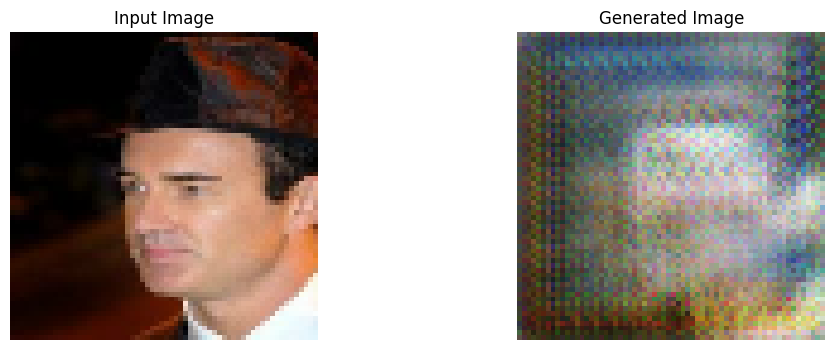

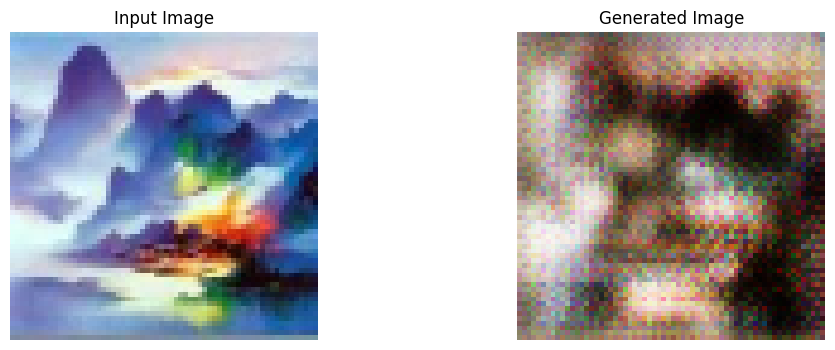


Epoch 2/20
Gen_G: 5.9655, Gen_F: 6.0595, Disc_X: 0.6083, Disc_Y: 0.6493


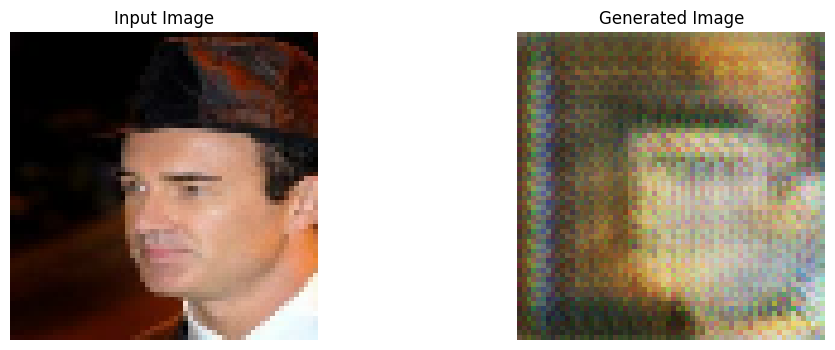

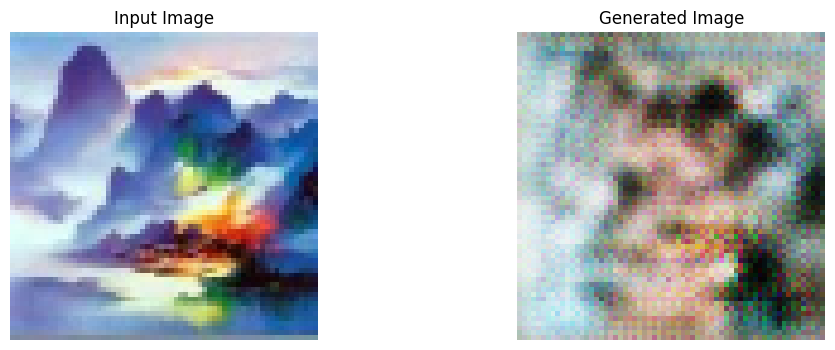


Epoch 3/20
Gen_G: 5.6541, Gen_F: 5.7300, Disc_X: 0.6108, Disc_Y: 0.6416


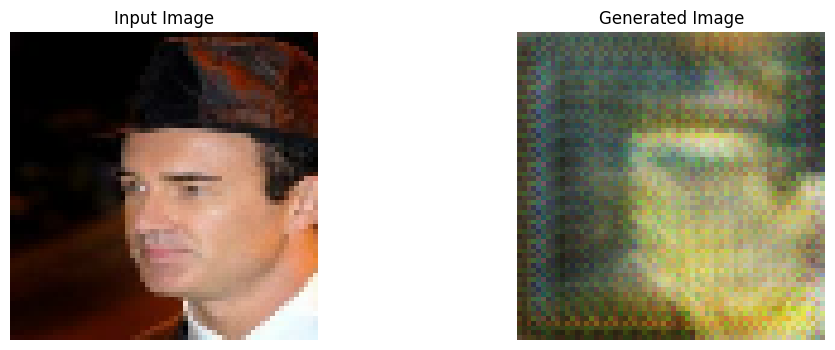

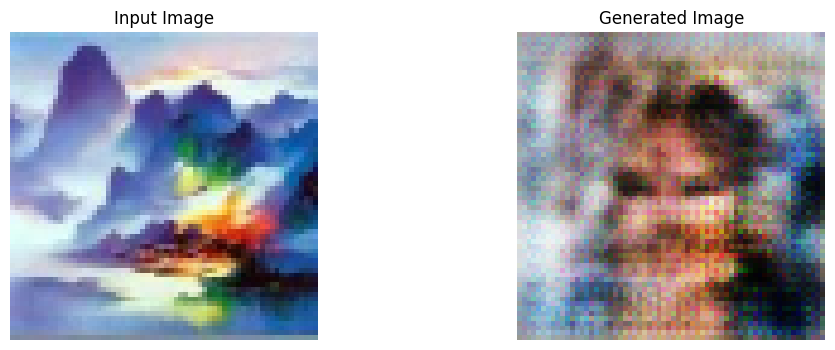


Epoch 4/20
Gen_G: 5.5875, Gen_F: 5.7182, Disc_X: 0.5673, Disc_Y: 0.6259


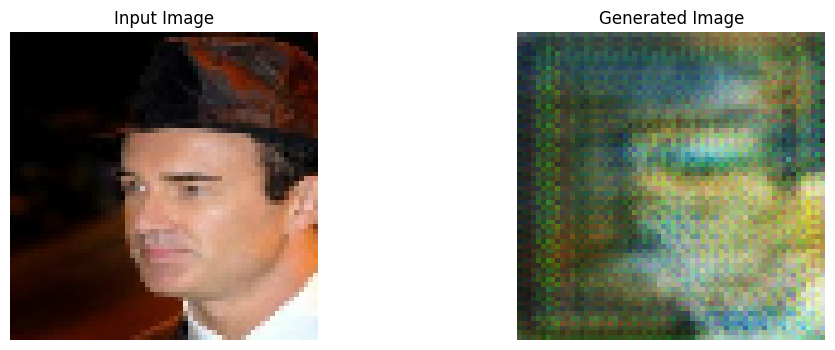

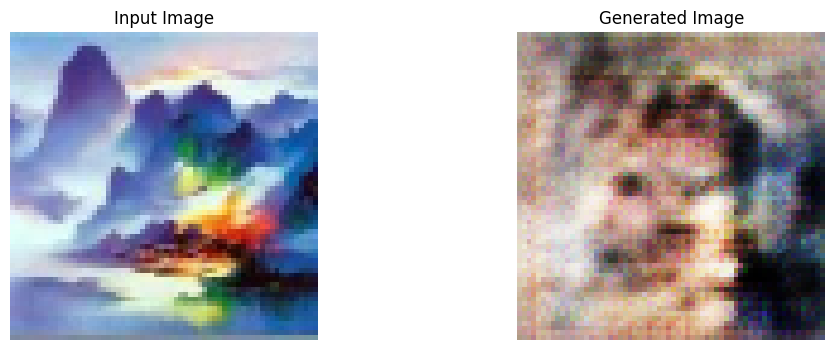


Epoch 5/20
Gen_G: 5.5590, Gen_F: 5.7665, Disc_X: 0.5191, Disc_Y: 0.6094


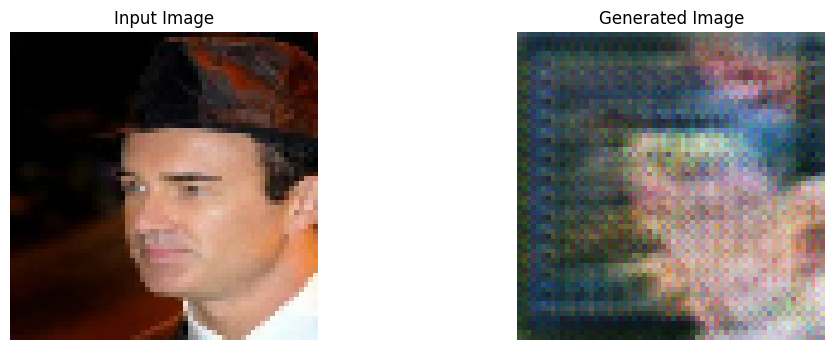

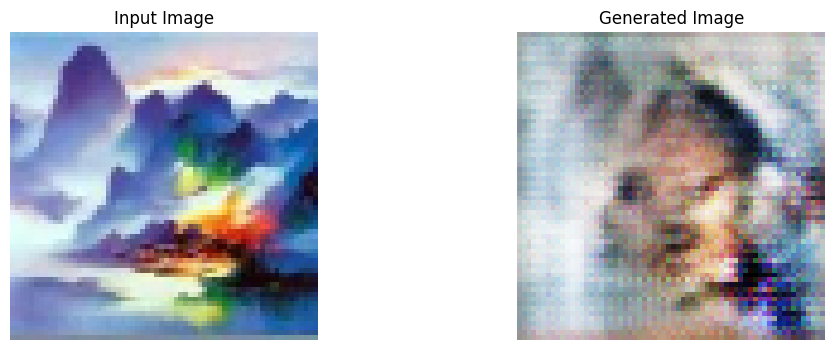


Epoch 6/20
Gen_G: 5.4853, Gen_F: 5.6743, Disc_X: 0.5551, Disc_Y: 0.6195


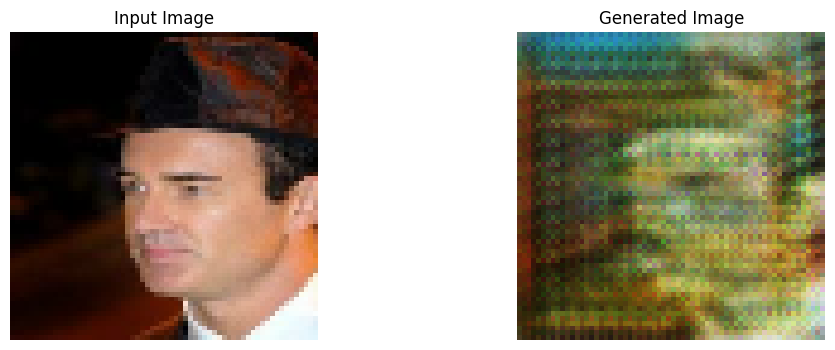

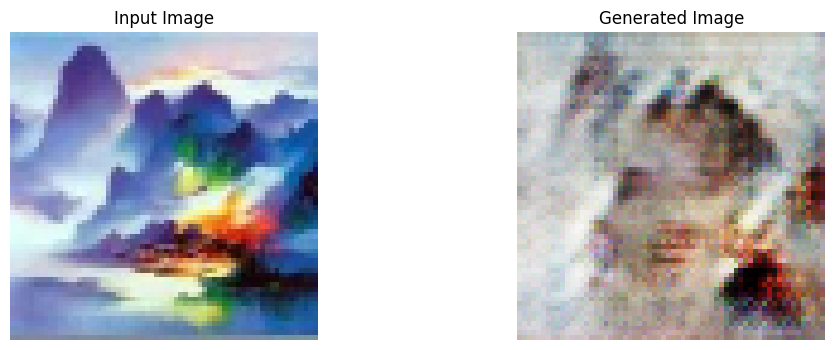


Epoch 7/20
Gen_G: 5.4551, Gen_F: 5.5718, Disc_X: 0.5530, Disc_Y: 0.5948


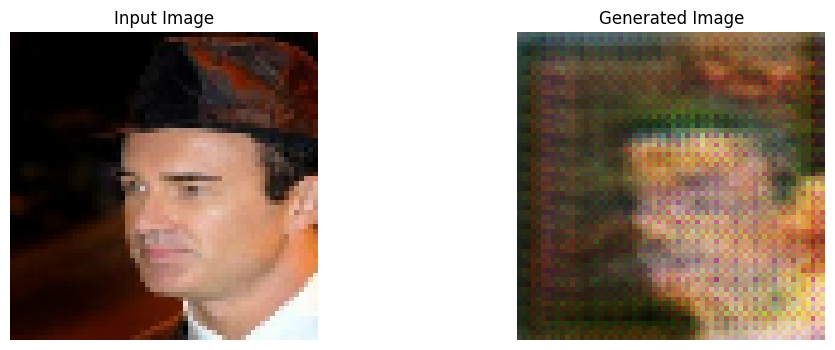

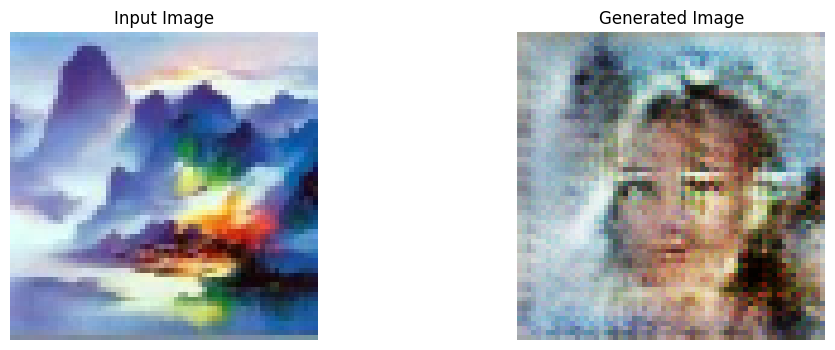


Epoch 8/20
Gen_G: 5.3561, Gen_F: 5.4934, Disc_X: 0.5574, Disc_Y: 0.6086


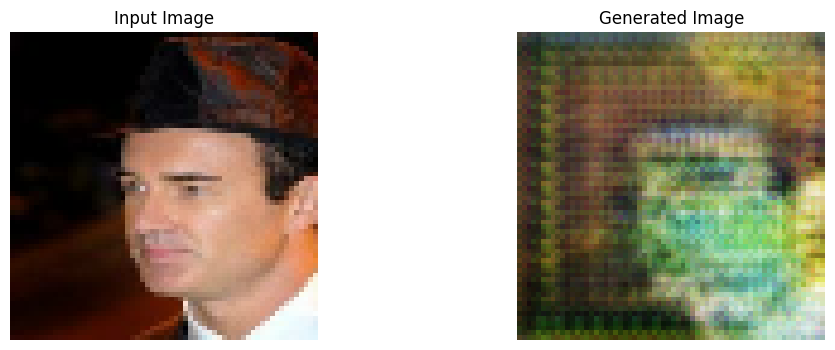

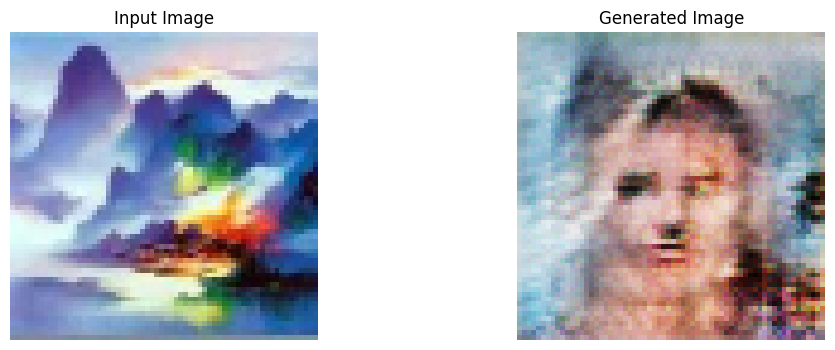


Epoch 9/20
Gen_G: 5.3541, Gen_F: 5.4402, Disc_X: 0.5742, Disc_Y: 0.6025


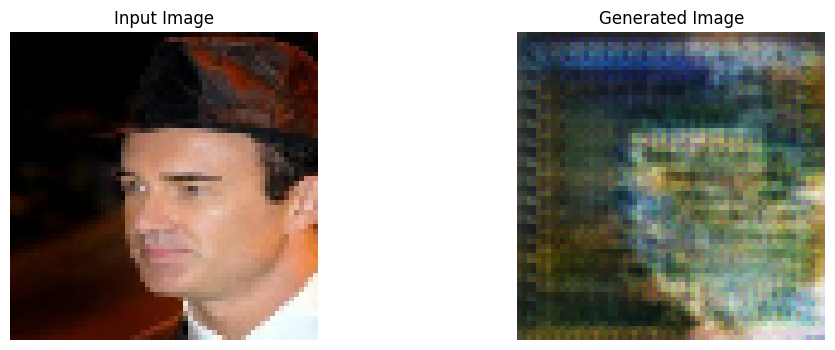

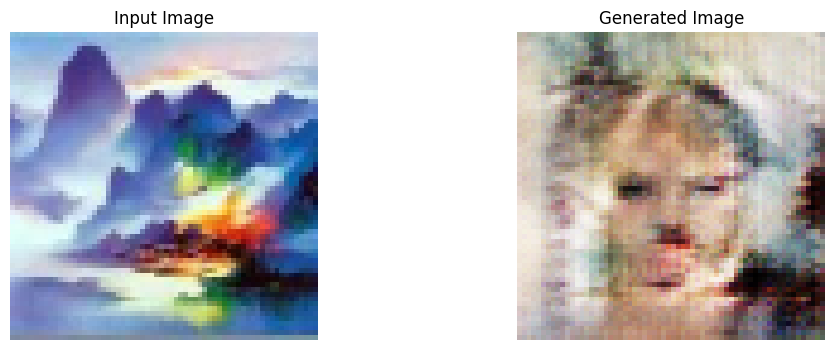


Epoch 10/20
Gen_G: 5.2948, Gen_F: 5.3845, Disc_X: 0.5645, Disc_Y: 0.6043


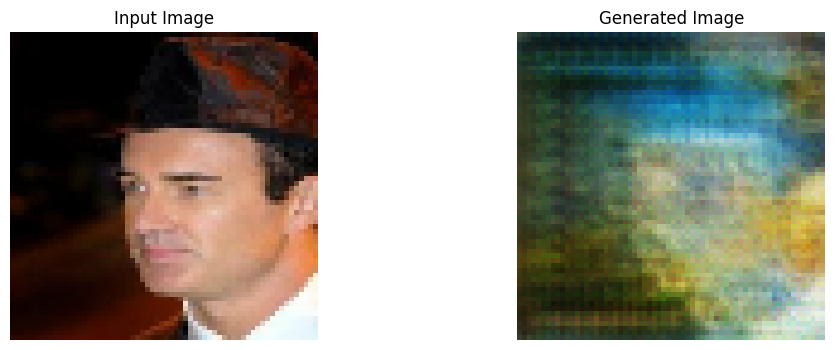

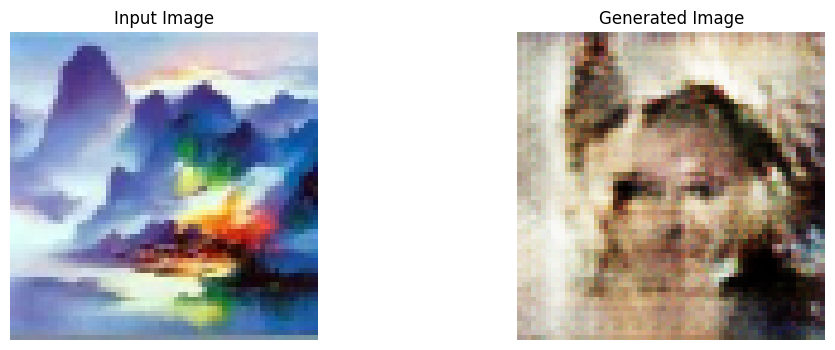


Epoch 11/20
Gen_G: 5.2060, Gen_F: 5.3898, Disc_X: 0.5514, Disc_Y: 0.6174


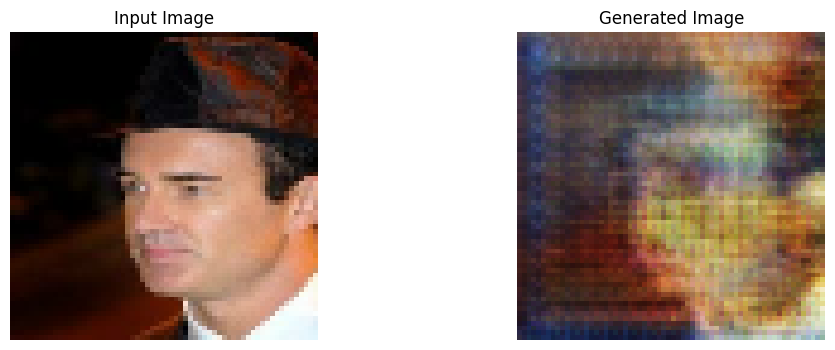

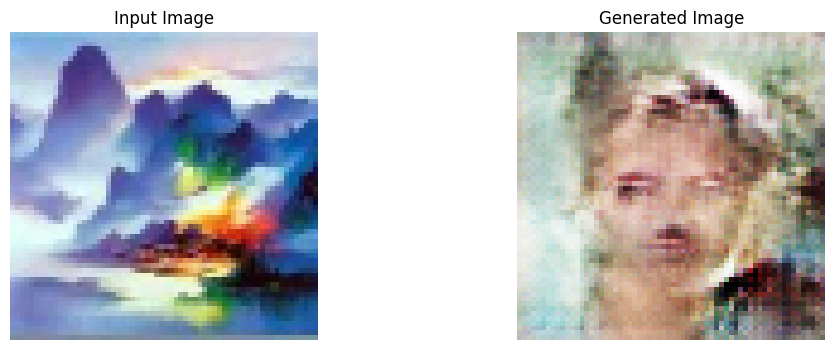


Epoch 12/20
Gen_G: 5.1355, Gen_F: 5.3093, Disc_X: 0.5431, Disc_Y: 0.6143


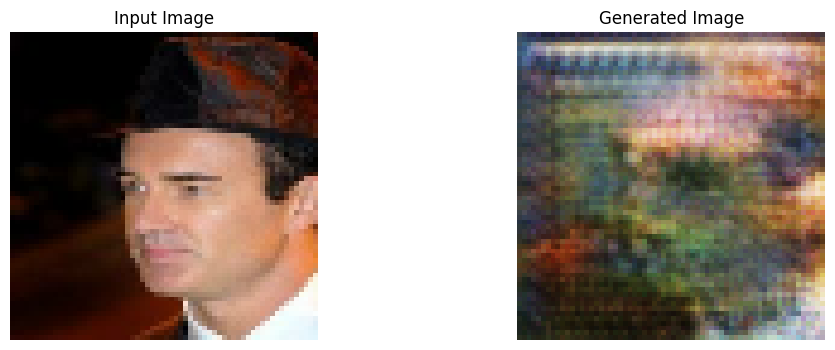

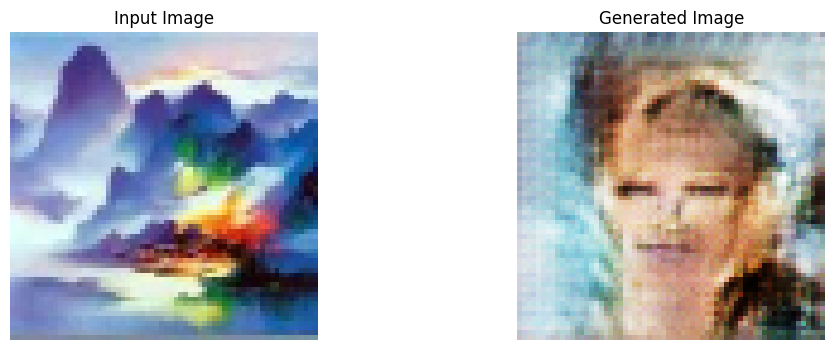


Epoch 13/20
Gen_G: 5.1899, Gen_F: 5.3902, Disc_X: 0.5430, Disc_Y: 0.6065


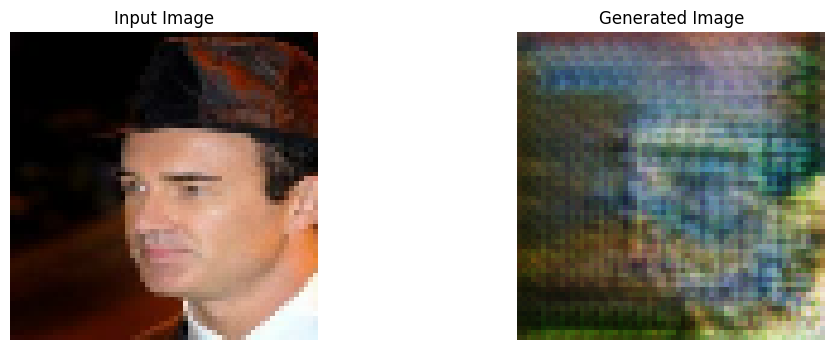

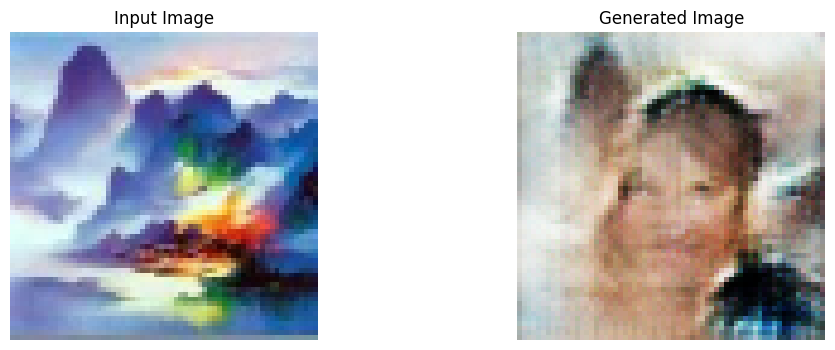


Epoch 14/20
Gen_G: 5.1124, Gen_F: 5.3096, Disc_X: 0.5392, Disc_Y: 0.6201


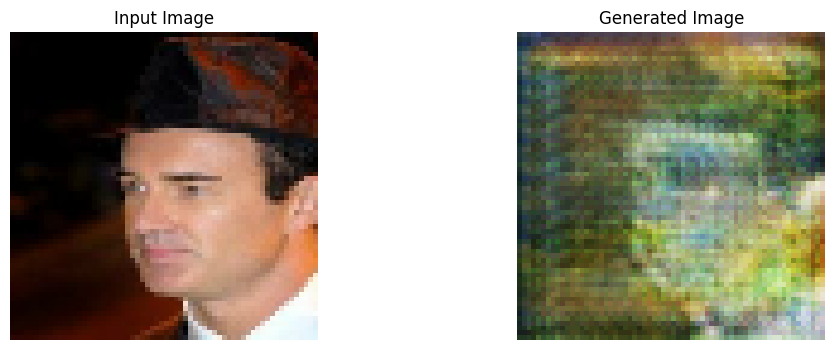

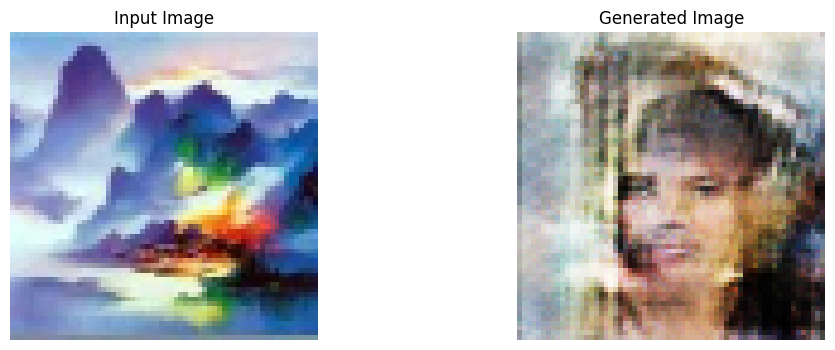


Epoch 15/20
Gen_G: 5.0048, Gen_F: 5.2529, Disc_X: 0.5363, Disc_Y: 0.6242


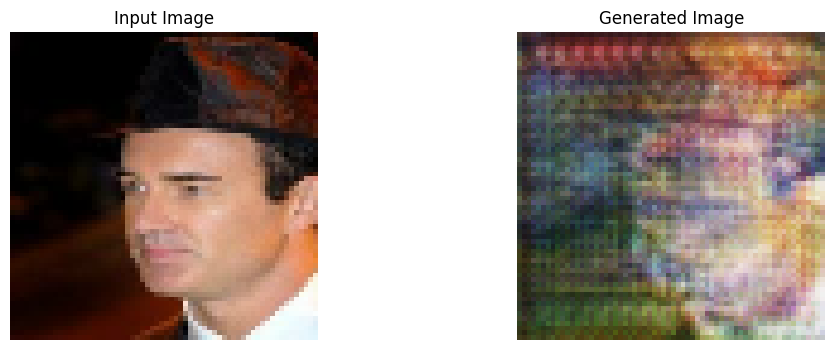

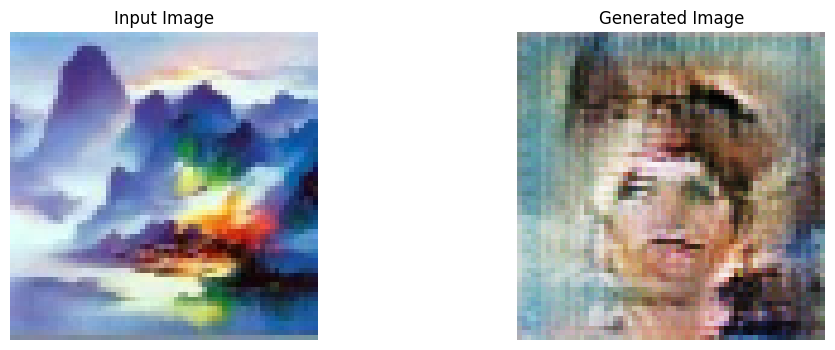


Epoch 16/20
Gen_G: 4.9859, Gen_F: 5.1930, Disc_X: 0.5575, Disc_Y: 0.6242


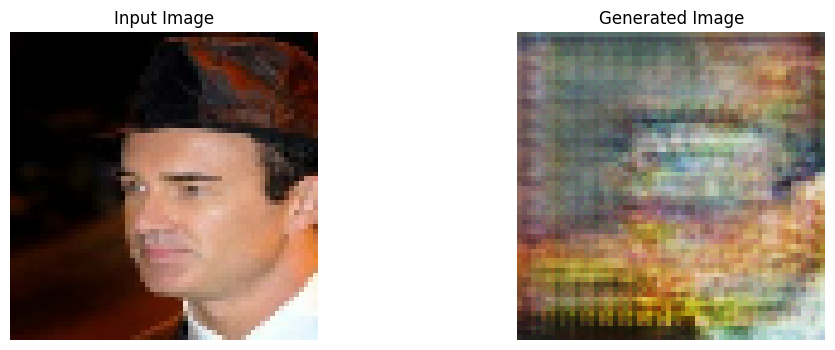

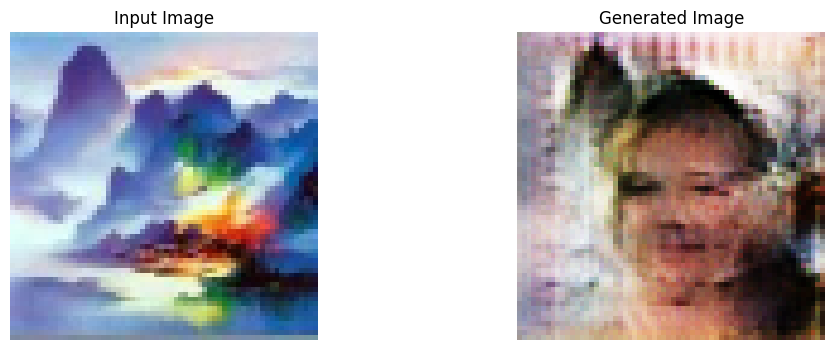


Epoch 17/20
Gen_G: 4.9015, Gen_F: 5.0975, Disc_X: 0.5543, Disc_Y: 0.6194


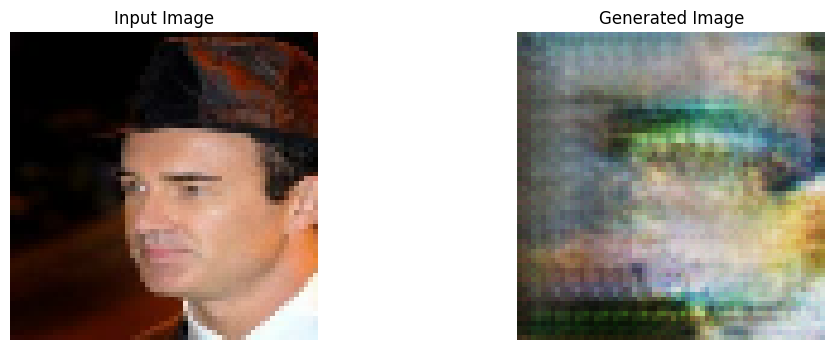

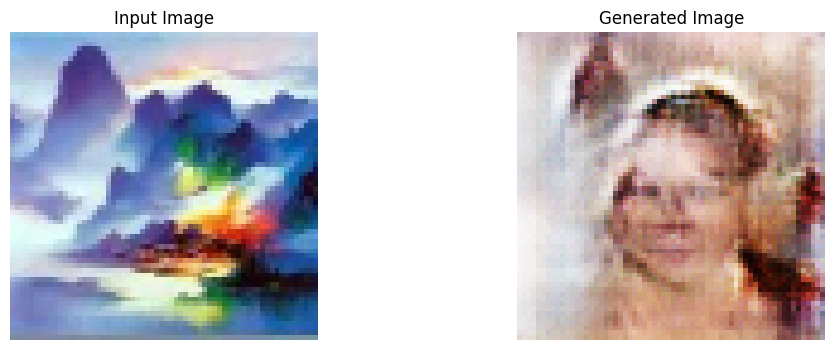


Epoch 18/20
Gen_G: 4.8649, Gen_F: 5.0558, Disc_X: 0.5423, Disc_Y: 0.6042


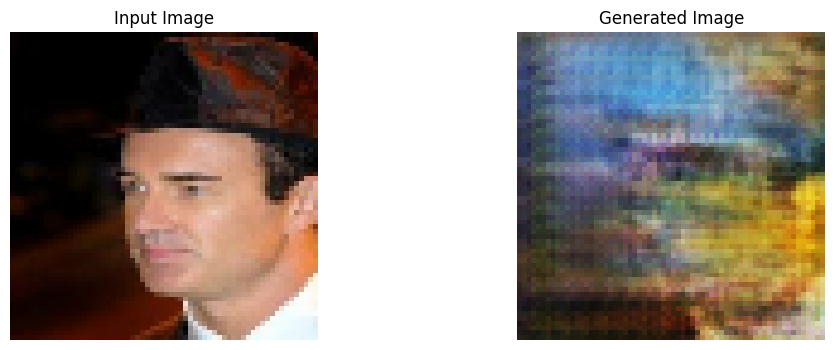

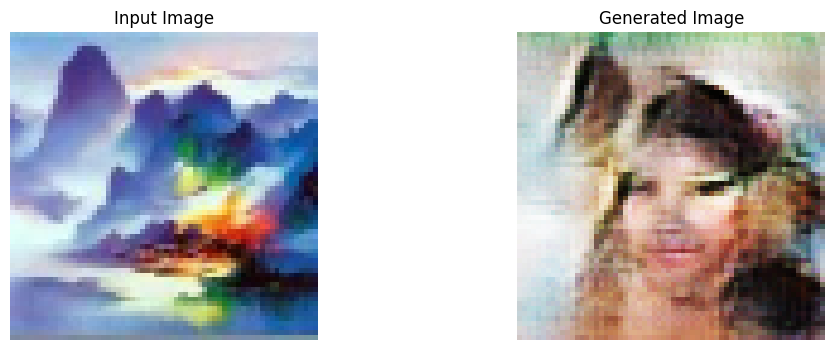


Epoch 19/20
Gen_G: 4.8663, Gen_F: 5.0200, Disc_X: 0.5653, Disc_Y: 0.6089


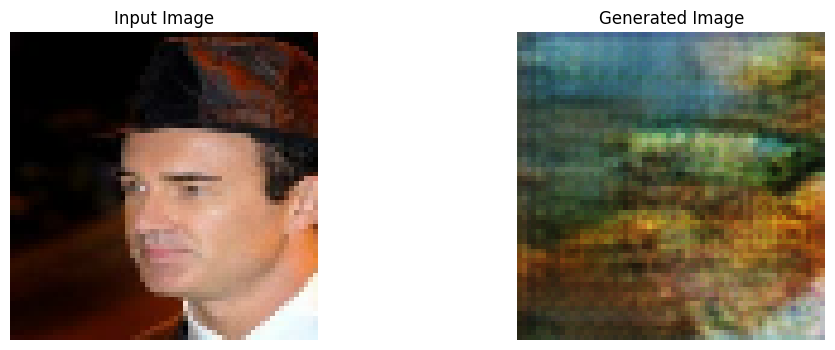

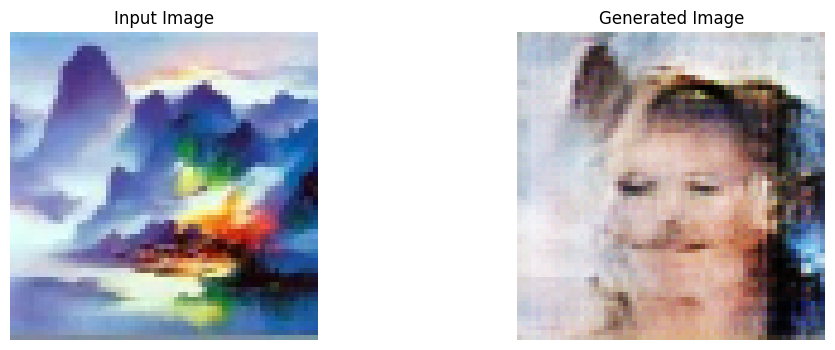


Epoch 20/20
Gen_G: 4.8809, Gen_F: 5.0090, Disc_X: 0.5547, Disc_Y: 0.5948


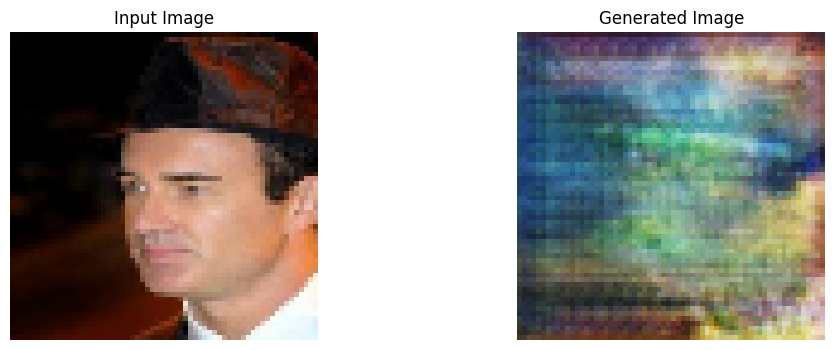

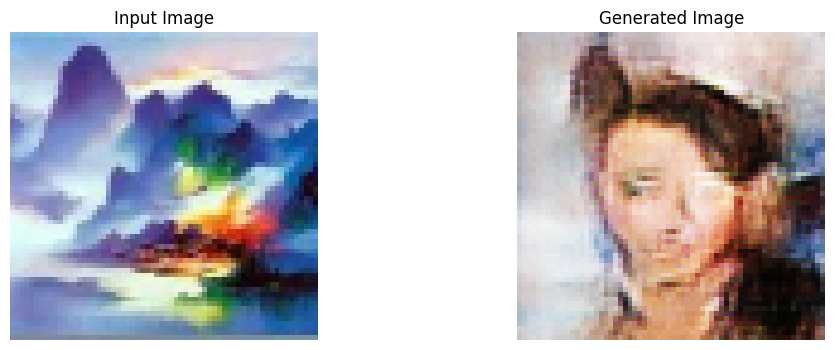

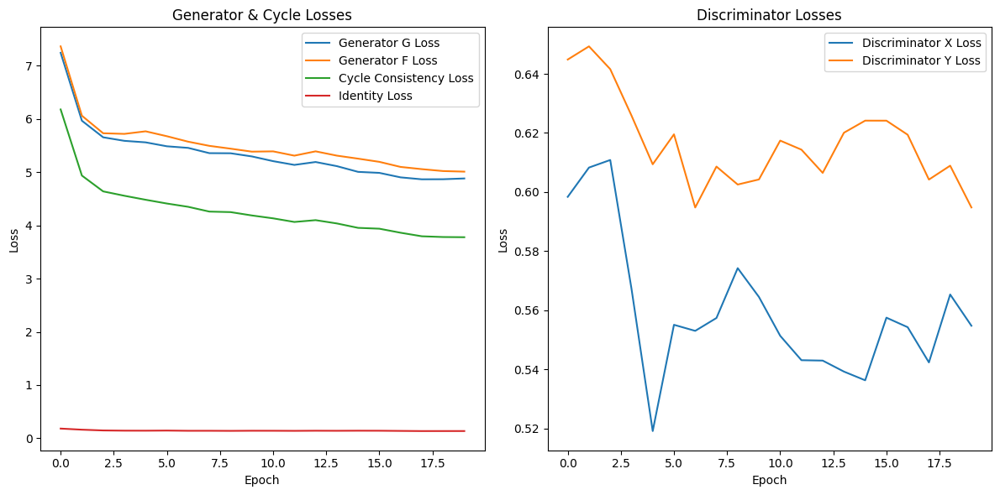

In [4]:
# Cell 1: Import Libraries and Setup (same as before)
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
from tensorflow import keras
from tensorflow.keras import layers
import cv2
from PIL import Image
import zipfile
import requests
from sklearn.model_selection import train_test_split
import random
import glob

print("TensorFlow version:", tf.__version__)
print("GPU Available:", tf.config.list_physical_devices('GPU'))

# Set random seeds for reproducibility
tf.random.set_seed(42)
np.random.seed(42)
random.seed(42)

# Cell 2: Configuration and Hyperparameters (MODIFIED FOR 64x64)
class Config:
    # Reduced image dimensions to prevent crashes
    IMG_HEIGHT = 64
    IMG_WIDTH = 64
    IMG_CHANNELS = 3

    # Training parameters
    BATCH_SIZE = 32  # Increased batch size since images are smaller
    EPOCHS = 20
    LEARNING_RATE = 2e-4
    BETA_1 = 0.5

    # Loss weights
    LAMBDA_CYCLE = 10.0
    LAMBDA_IDENTITY = 0.5

    # Data paths
    CELEBA_PATH = path1+"/img_align_celeba/img_align_celeba"
    PAINTINGS_PATH = path2+"/paintings"

    # Model checkpoints
    CHECKPOINT_PATH = "/content/checkpoints"

config = Config()

# Cell 3: Data Loading and Preprocessing Functions (MODIFIED)
def verify_datasets():
    """Verify dataset paths and files"""
    print("Verifying dataset paths...")

    # Check CelebA dataset
    celeba_files = glob.glob(f"{config.CELEBA_PATH}/*.jpg")
    print(f"Found {len(celeba_files)} CelebA images")
    if len(celeba_files) == 0:
        print("Error: No JPG files found in CelebA path!")
        print("Current CelebA path:", config.CELEBA_PATH)
        print("Files in directory:", os.listdir(config.CELEBA_PATH)[:10])

    # Check paintings dataset
    painting_files = glob.glob(f"{config.PAINTINGS_PATH}/*.jpg")
    print(f"Found {len(painting_files)} painting images")

    return len(celeba_files) > 0 and len(painting_files) > 0

def preprocess_image(image_path, target_size=(64, 64)):  # Changed to 64x64
    """Preprocess image for training"""
    image = tf.io.read_file(image_path)
    image = tf.image.decode_image(image, channels=3, expand_animations=False)
    image = tf.cast(image, tf.float32)

    # Resize and normalize to [-1, 1]
    image = tf.image.resize(image, target_size)
    image = (image / 127.5) - 1.0

    return image

def load_dataset(face_dir, painting_dir, batch_size=4):  # Increased batch size
    """Load and prepare datasets"""
    try:
        face_files = tf.data.Dataset.list_files(f"{face_dir}/*.jpg", shuffle=True)
        painting_files = tf.data.Dataset.list_files(f"{painting_dir}/*.jpg", shuffle=True)
    except tf.errors.NotFoundError as e:
        print(f"Error loading files: {e}")
        print("Please verify the dataset paths:")
        print(f"CelebA path: {face_dir}")
        print(f"Paintings path: {painting_dir}")
        raise

    # Preprocess images with reduced size
    face_dataset = face_files.map(
        lambda x: preprocess_image(x, (64, 64)),  # Explicit 64x64 size
        num_parallel_calls=tf.data.AUTOTUNE
    ).batch(batch_size).prefetch(tf.data.AUTOTUNE)

    painting_dataset = painting_files.map(
        lambda x: preprocess_image(x, (64, 64)),  # Explicit 64x64 size
        num_parallel_calls=tf.data.AUTOTUNE
    ).batch(batch_size).prefetch(tf.data.AUTOTUNE)

    return face_dataset, painting_dataset


# Cell 4: Generator Architecture with Custom Instance Normalization
class InstanceNormalization(layers.Layer):
    """Custom Instance Normalization layer"""
    def __init__(self, epsilon=1e-5, **kwargs):
        super(InstanceNormalization, self).__init__(**kwargs)
        self.epsilon = epsilon

    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer='ones',
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
        super(InstanceNormalization, self).build(input_shape)

    def call(self, x):
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

def downsample(filters, size, apply_instancenorm=True):
    """Downsampling layer"""
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(layers.Conv2D(filters, size, strides=2, padding='same',
                            kernel_initializer=initializer, use_bias=False))

    if apply_instancenorm:
        result.add(InstanceNormalization())

    result.add(layers.LeakyReLU())

    return result

def upsample(filters, size, apply_dropout=False):
    """Upsampling layer"""
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                     kernel_initializer=initializer, use_bias=False))
    result.add(InstanceNormalization())

    if apply_dropout:
        result.add(layers.Dropout(0.5))

    result.add(layers.ReLU())

    return result

def residual_block(filters):
    """Residual block for generator"""
    initializer = tf.random_normal_initializer(0., 0.02)

    def apply(x):
        input_x = x

        x = layers.Conv2D(filters, 3, padding='same',
                         kernel_initializer=initializer, use_bias=False)(x)
        x = InstanceNormalization()(x)
        x = layers.ReLU()(x)

        x = layers.Conv2D(filters, 3, padding='same',
                         kernel_initializer=initializer, use_bias=False)(x)
        x = InstanceNormalization()(x)

        return layers.Add()([input_x, x])

    return apply

def Generator():
    """CycleGAN Generator with ResNet architecture (modified for 64x64)"""
    inputs = layers.Input(shape=[64, 64, 3])  # Changed to 64x64

    # Initial convolution
    x = layers.Conv2D(32, 7, padding='same', use_bias=False)(inputs)  # Reduced filters
    x = InstanceNormalization()(x)
    x = layers.ReLU()(x)

    # Downsampling
    x = downsample(64, 3)(x)  # Reduced filters
    x = downsample(128, 3)(x)  # Reduced filters

    # Fewer residual blocks for smaller images
    for _ in range(6):  # Reduced from 9 to 6
        x = residual_block(128)(x)  # Reduced filters

    # Upsampling
    x = upsample(64, 3)(x)  # Reduced filters
    x = upsample(32, 3)(x)  # Reduced filters

    # Output layer
    x = layers.Conv2D(3, 7, padding='same',
                     kernel_initializer=tf.random_normal_initializer(0., 0.02))(x)
    x = layers.Activation('tanh')(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

# Cell 5: Discriminator Architecture (MODIFIED FOR 64x64)
def Discriminator():
    """PatchGAN Discriminator (modified for 64x64)"""
    initializer = tf.random_normal_initializer(0., 0.02)

    inp = layers.Input(shape=[64, 64, 3])  # Changed to 64x64

    x = downsample(32, 4, False)(inp)  # Reduced filters
    x = downsample(64, 4)(x)  # Reduced filters
    x = downsample(128, 4)(x)  # Reduced filters

    # Zero padding
    x = layers.ZeroPadding2D()(x)
    x = layers.Conv2D(256, 4, kernel_initializer=initializer, use_bias=False)(x)  # Reduced filters
    x = InstanceNormalization()(x)
    x = layers.LeakyReLU()(x)

    # Final layer
    x = layers.ZeroPadding2D()(x)
    x = layers.Conv2D(1, 4, kernel_initializer=initializer)(x)

    return tf.keras.Model(inputs=inp, outputs=x)


# Cell 6: Loss Functions
def discriminator_loss(real, generated):
    """Discriminator loss"""
    real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(
        tf.ones_like(real), real)

    generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(
        tf.zeros_like(generated), generated)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss * 0.5

def generator_loss(generated):
    """Generator loss"""
    return tf.keras.losses.BinaryCrossentropy(from_logits=True)(
        tf.ones_like(generated), generated)

def calc_cycle_loss(real_image, cycled_image):
    """Cycle consistency loss"""
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return config.LAMBDA_CYCLE * loss1

def identity_loss(real_image, same_image):
    """Identity loss"""
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return config.LAMBDA_IDENTITY * 0.5 * loss

# Cell 7: Model Initialization and Optimizers
# Initialize models
generator_g = Generator()  # Face to Painting
generator_f = Generator()  # Painting to Face
discriminator_x = Discriminator()  # Face discriminator
discriminator_y = Discriminator()  # Painting discriminator

# Optimizers
generator_g_optimizer = tf.keras.optimizers.Adam(config.LEARNING_RATE, beta_1=config.BETA_1)
generator_f_optimizer = tf.keras.optimizers.Adam(config.LEARNING_RATE, beta_1=config.BETA_1)
discriminator_x_optimizer = tf.keras.optimizers.Adam(config.LEARNING_RATE, beta_1=config.BETA_1)
discriminator_y_optimizer = tf.keras.optimizers.Adam(config.LEARNING_RATE, beta_1=config.BETA_1)

print("Models initialized successfully!")

# Cell 8: Training Step Function
@tf.function
def train_step(real_x, real_y):
    """Single training step"""
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X

        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)

        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)

        # Identity mapping
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)

        # Discriminator outputs
        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)

        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        # Generator losses
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        # Cycle losses
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

        # Identity losses
        total_identity_loss = identity_loss(real_y, same_y) + identity_loss(real_x, same_x)

        # Total generator losses
        total_gen_g_loss = gen_g_loss + total_cycle_loss + total_identity_loss
        total_gen_f_loss = gen_f_loss + total_cycle_loss + total_identity_loss

        # Discriminator losses
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

    # Calculate gradients
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)

    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

    # Apply gradients
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))

    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

    return {
        'gen_g_loss': total_gen_g_loss,
        'gen_f_loss': total_gen_f_loss,
        'disc_x_loss': disc_x_loss,
        'disc_y_loss': disc_y_loss,
        'cycle_loss': total_cycle_loss,
        'identity_loss': total_identity_loss
    }

# Cell 9: Utility Functions for Visualization
def generate_images(model, test_input, save_path=None):
    """Generate and display images"""
    prediction = model(test_input)

    plt.figure(figsize=(12, 4))

    display_list = [test_input[0], prediction[0]]
    title = ['Input Image', 'Generated Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        # Denormalize image from [-1, 1] to [0, 1]
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')

    if save_path:
        plt.savefig(save_path)
    plt.show()

def save_model_weights(epoch):
    """Save model weights"""
    os.makedirs(config.CHECKPOINT_PATH, exist_ok=True)

    generator_g.save_weights(f"{config.CHECKPOINT_PATH}/gen_g_epoch_{epoch}.weights.h5")
    generator_f.save_weights(f"{config.CHECKPOINT_PATH}/gen_f_epoch_{epoch}.weights.h5")
    discriminator_x.save_weights(f"{config.CHECKPOINT_PATH}/disc_x_epoch_{epoch}.weights.h5")
    discriminator_y.save_weights(f"{config.CHECKPOINT_PATH}/disc_y_epoch_{epoch}.weights.h5")

# Cell 10: Training Loop
def train_cyclegan(face_dataset, painting_dataset, epochs):
    """Main training loop with reduced memory usage"""
    os.makedirs(config.CHECKPOINT_PATH, exist_ok=True)
    os.makedirs("generated_samples", exist_ok=True)

    # Fixed sample batches
    fixed_face = next(iter(face_dataset.take(1)))
    fixed_painting = next(iter(painting_dataset.take(1)))

    # Initialize lists to store epoch-wise losses
    history = {
        'gen_g_loss': [],
        'gen_f_loss': [],
        'disc_x_loss': [],
        'disc_y_loss': [],
        'cycle_loss': [],
        'identity_loss': []
    }

    for epoch in range(epochs):
        print(f"\nEpoch {epoch + 1}/{epochs}")
        gen_g_loss_avg = tf.keras.metrics.Mean()
        gen_f_loss_avg = tf.keras.metrics.Mean()
        disc_x_loss_avg = tf.keras.metrics.Mean()
        disc_y_loss_avg = tf.keras.metrics.Mean()
        cycle_loss_avg = tf.keras.metrics.Mean()
        identity_loss_avg = tf.keras.metrics.Mean()

        for step, (real_x, real_y) in enumerate(zip(face_dataset, painting_dataset)):
            if step >= 500:
                break

            losses = train_step(real_x, real_y)

            gen_g_loss_avg.update_state(losses['gen_g_loss'])
            gen_f_loss_avg.update_state(losses['gen_f_loss'])
            disc_x_loss_avg.update_state(losses['disc_x_loss'])
            disc_y_loss_avg.update_state(losses['disc_y_loss'])
            cycle_loss_avg.update_state(losses['cycle_loss'])
            identity_loss_avg.update_state(losses['identity_loss'])

        # Save epoch averages to history
        history['gen_g_loss'].append(gen_g_loss_avg.result().numpy())
        history['gen_f_loss'].append(gen_f_loss_avg.result().numpy())
        history['disc_x_loss'].append(disc_x_loss_avg.result().numpy())
        history['disc_y_loss'].append(disc_y_loss_avg.result().numpy())
        history['cycle_loss'].append(cycle_loss_avg.result().numpy())
        history['identity_loss'].append(identity_loss_avg.result().numpy())

        # Print epoch summary
        print(f"Gen_G: {history['gen_g_loss'][-1]:.4f}, "
              f"Gen_F: {history['gen_f_loss'][-1]:.4f}, "
              f"Disc_X: {history['disc_x_loss'][-1]:.4f}, "
              f"Disc_Y: {history['disc_y_loss'][-1]:.4f}")

        # Sample generation
        generate_images(generator_g, fixed_face,
                        f"generated_samples/face_to_painting_epoch_{epoch + 1}.png")
        generate_images(generator_f, fixed_painting,
                        f"generated_samples/painting_to_face_epoch_{epoch + 1}.png")

        if (epoch + 1) % 10 == 0:
            save_model_weights(epoch + 1)

    return history

# Cell 11: Data Loading and Training Execution
try:
    # Load datasets
    print("Loading datasets...")
    face_dataset, painting_dataset = load_dataset(
        config.CELEBA_PATH,
        config.PAINTINGS_PATH,
        config.BATCH_SIZE
    )

    print("Starting training...")
    history = train_cyclegan(face_dataset, painting_dataset, config.EPOCHS)

except Exception as e:
    print(f"Error during training: {e}")
    print("Make sure you have prepared the datasets in the correct directories:")
    print(f"- CelebA faces in: {config.CELEBA_PATH}")
    print(f"- Painting images in: {config.PAINTINGS_PATH}")

# Cell 12: Model Loading and Inference
def load_trained_model(epoch):
    """Load trained model weights"""
    generator_g.load_weights(f"{config.CHECKPOINT_PATH}/gen_g_epoch_{epoch}.weights.h5")
    generator_f.load_weights(f"{config.CHECKPOINT_PATH}/gen_f_epoch_{epoch}.weights.h5")
    print(f"Loaded model weights from epoch {epoch}")

def convert_face_to_painting(image_path):
    """Convert a single face image to painting style"""
    # Load and preprocess image
    image = preprocess_image(image_path)
    image = tf.expand_dims(image, 0)  # Add batch dimension

    # Generate painting
    painting = generator_g(image, training=False)

    # Display results
    generate_images(generator_g, image)

    return painting

def convert_painting_to_face(image_path):
    """Convert a painting to face style"""
    # Load and preprocess image
    image = preprocess_image(image_path)
    image = tf.expand_dims(image, 0)  # Add batch dimension

    # Generate face
    face = generator_f(image, training=False)

    # Display results
    generate_images(generator_f, image)

    return face

# Cell 13: Evaluation and Testing
def evaluate_model(test_face_dataset, test_painting_dataset, num_samples=5):
    """Evaluate the trained model"""
    print("Evaluating model...")

    # Test face to painting conversion
    print("Face to Painting conversions:")
    for i, face_batch in enumerate(test_face_dataset.take(num_samples)):
        painting = generator_g(face_batch, training=False)
        generate_images(generator_g, face_batch,
                       f"evaluation/face_to_painting_{i}.png")

    # Test painting to face conversion
    print("Painting to Face conversions:")
    for i, painting_batch in enumerate(test_painting_dataset.take(num_samples)):
        face = generator_f(painting_batch, training=False)
        generate_images(generator_f, painting_batch,
                       f"evaluation/painting_to_face_{i}.png")

def plot_training_history(history):
    """Plot the losses over training epochs"""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.plot(history['gen_g_loss'], label='Generator G Loss')
    plt.plot(history['gen_f_loss'], label='Generator F Loss')
    plt.plot(history['cycle_loss'], label='Cycle Consistency Loss')
    plt.plot(history['identity_loss'], label='Identity Loss')
    plt.title("Generator & Cycle Losses")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history['disc_x_loss'], label='Discriminator X Loss')
    plt.plot(history['disc_y_loss'], label='Discriminator Y Loss')
    plt.title("Discriminator Losses")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()

    plt.tight_layout()
    plt.savefig("loss_plot.png")
    plt.show()


plot_training_history(history)

